<a href="https://colab.research.google.com/github/JonPeterP/PresidentFaceReco/blob/main/CS124P_Midterms_Face_Pomperada.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# **Install and Mount Drive**

In [1]:
!pip install face_recognition

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.1/100.1 MB 9.9 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for face-recognition-models: filename=face_recognition_models-0.3.0-py2.py3-none-any.whl size=100566171 sha256=cc8b5140e40f2026fd2ccf552b7d3ae3641eefbc404acc446cff9ee26e232bdb
  Stored in directory: /root/.cache/pip/wheels/7a/eb/cf/e9eced74122b679557f597bb7c8e4c739cfcac526db1fd523d
Successfully built face-recognition-models


In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


# **IMPORTS**

In [25]:
##encode faces
# import the necessary packages
from imutils import paths
import face_recognition
import argparse
import pickle
import cv2

##Recognize faces image
import argparse
import pickle
import random
from queue import Queue
import matplotlib.pyplot as plt
from IPython.display import clear_output
from time import sleep
from google.colab.patches import cv2_imshow
from google.colab import drive

#KNN
import math
from sklearn import neighbors
import os
import os.path
from PIL import Image, ImageDraw, ImageFont
from face_recognition.face_recognition_cli import image_files_in_folder


# video stream capture import dependencies
from IPython.display import display, Javascript, Image
#from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode, b64encode
import cv2
import numpy as np
import PIL
import io
import html
import time


# **Encoding**

In [ ]:
##encode faces

# # import the necessary packages
# from imutils import paths
# import face_recognition
# import argparse
# import pickle
# import cv2
# import os

from google.colab import drive

drive.mount('/content/drive')

pickleFile = '/content/drive/MyDrive/CS124P/Midterms/encodings.pickle'
datasetPath = '/content/drive/MyDrive/CS124P/Midterms/dataset'

# set the path to the input images in our dataset
print("quantifying faces from dataset path...")
imagePaths = list(paths.list_images(datasetPath))

# initialize the list of known encodings and known names
knownEncodings = []
knownNames = []

# loop over the image paths
for (i, imagePath) in enumerate(imagePaths):
    # extract the person name from the image path
    print("processing image {}/{}".format(i + 1,
        len(imagePaths)))
    name = imagePath.split(os.path.sep)[-2]

    # load the input image and convert it from BGR to RGB
    image = cv2.imread(imagePath)
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)

    # detect the (x, y)-coordinates of the bounding boxes
    # corresponding to each face in the input image
    boxes = face_recognition.face_locations(rgb, model="cnn")

    # compute the facial embedding for the face
    encodings = face_recognition.face_encodings(rgb, boxes)

    # loop over the encodings
    for encoding in encodings:
        # add each encoding + name to our set of known names and
        # encodings
        knownEncodings.append(encoding)
        knownNames.append(name)

# dump or save the facial encodings + names to disk
print("serializing encodings...")
data = {"encodings": knownEncodings, "names": knownNames}
f = open(pickleFile, "wb")
f.write(pickle.dumps(data))
f.close()

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).
quantifying faces from dataset path...
processing image 1/192
processing image 2/192
processing image 3/192
processing image 4/192
processing image 5/192
processing image 6/192
processing image 7/192
processing image 8/192
processing image 9/192
processing image 10/192
processing image 11/192
processing image 12/192
processing image 13/192
processing image 14/192
processing image 15/192
processing image 16/192
processing image 17/192
processing image 18/192
processing image 19/192
processing image 20/192
processing image 21/192
processing image 22/192
processing image 23/192
processing image 24/192
processing image 25/192
processing image 26/192
processing image 27/192
processing image 28/192
processing image 29/192
processing image 30/192
processing image 31/192
processing image 32/192
processing image 33/192
processing image 34/192
processing image 35/192
p

# **Face Recognition Class**

In [20]:
# ##Recognize faces image
# import face_recognition
# import argparse
# import pickle
# import cv2

# import random
# import os
# from queue import Queue

# import matplotlib.pyplot as plt
# from IPython import display
# from IPython.display import clear_output

# from time import sleep

# from google.colab.patches import cv2_imshow
# from google.colab import drive


dataSetPath = "/content/drive/MyDrive/CS124P/Midterms/dataset"


class FaceRecognition:
  data = None
  pickleFile = '/content/drive/MyDrive/CS124P/Midterms/encodings.pickle'

  def __init__(self):
    #encode images
    # load the trained faces through pickle.
    self.data = pickle.loads(open(self.pickleFile, "rb").read())

  def GetFace(self, filename):
    image = cv2.imread(filename)
    rgb = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    imageWithName = rgb.copy() #using rgb because plt was used to display image

    # detect faces and bounding box for each
    boxes = face_recognition.face_locations(rgb, model="cnn")
    encodings = face_recognition.face_encodings(rgb, boxes)

    # list for detected face
    names = []

    # loop over the facial embeddings
    for encoding in encodings:
      # match face in the input image to our known encodings
      matches = face_recognition.compare_faces(self.data["encodings"], encoding)
      name = "Unknown"

      # check to see if we have found a match
      if True in matches:
        # find the indexes of all matched faces then initialize a
        # dictionary to count the total number of times each face
        # was matched
        matchedIdxs = [i for (i, b) in enumerate(matches) if b]
        counts = {}

        # loop over the matched indexes and maintain a count for
        # each recognized face face
        for i in matchedIdxs:
          name = self.data["names"][i]
          counts[name] = counts.get(name, 0) + 1

        # determine the recognized face with the largest number of
        # votes (note: in the event of an unlikely tie Python will
        # select first entry in the dictionary)
        name = max(counts, key=counts.get)

      # update the list of names
      names.append(name)

     # loop over the recognized faces
    for ((top, right, bottom, left), name) in zip(boxes, names):
      # draw the predicted face name on the image

      if name != "Unknown":
        #cv2.rectangle(rgb, (left, top), (right, bottom), (0, 255, 0), 2) #rgb for plt
        cv2.rectangle(imageWithName, (left, top), (right, bottom), (0, 255, 0), 2) #Bounding box for imageWithName

        y = top - 15 if top - 15 > 15 else top + 15
        cv2.putText(imageWithName, name, (left, y), cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0, 255, 0), 2)

    return (names, rgb, imageWithName)


  def GetFaceVideo(self, filename):
    rgb = cv2.cvtColor(filename, cv2.COLOR_BGR2RGB)
    imageWithName = rgb.copy() #using rgb because plt was used to display image

    # detect faces and bounding box for each
    boxes = face_recognition.face_locations(rgb, model="cnn")
    encodings = face_recognition.face_encodings(rgb, boxes)

    # list for detected face
    names = []

    # loop over the facial embeddings
    for encoding in encodings:
      # match face in the input image to our known encodings
      matches = face_recognition.compare_faces(self.data["encodings"], encoding)
      name = "Unknown"

      # check to see if we have found a match
      if True in matches:
        # find the indexes of all matched faces then initialize a
        # dictionary to count the total number of times each face
        # was matched
        matchedIdxs = [i for (i, b) in enumerate(matches) if b]
        counts = {}

        # loop over the matched indexes and maintain a count for
        # each recognized face face
        for i in matchedIdxs:
          name = self.data["names"][i]
          counts[name] = counts.get(name, 0) + 1

        # determine the recognized face with the largest number of
        # votes (note: in the event of an unlikely tie Python will
        # select first entry in the dictionary)
        name = max(counts, key=counts.get)

      # update the list of names
      names.append(name)

    # loop over the recognized faces
    for ((top, right, bottom, left), name) in zip(boxes, names):
      # draw the predicted face name on the image

      if name != "Unknown":
        ##cv2.rectangle(image, (left, top), (right, bottom), (0, 255, 0), 2)
        #cv2.rectangle(rgb, (left, top), (right, bottom), (0, 255, 0), 2) #rgb for plt
        cv2.rectangle(imageWithName, (left, top), (right, bottom), (0, 255, 0), 2) #Bounding box for imageWithName

        y = top - 15 if top - 15 > 15 else top + 15
        cv2.putText(imageWithName, name, (left, y), cv2.FONT_HERSHEY_SIMPLEX, 0.75, (0, 255, 0), 2)

    return (names, rgb, imageWithName)

  def distanceCalculate(p1, p2):
      """p1 and p2 in format (x1,y1) and (x2,y2) tuples"""
      dis = ((p2[0] - p1[0]) ** 2 + (p2[1] - p1[1]) ** 2) ** 0.5
      return dis





# **FaceRecognition Class Checker**

fidel01.png
<class 'numpy.ndarray'>


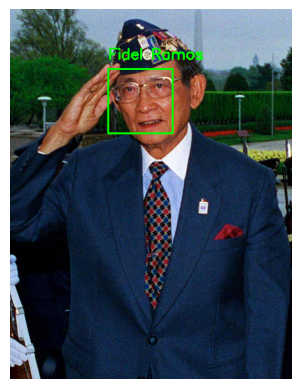

fidel02.png
<class 'numpy.ndarray'>


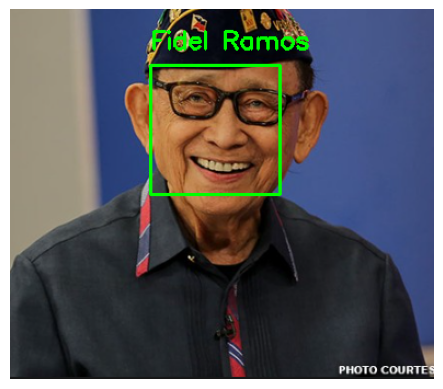

fidel03.png
<class 'numpy.ndarray'>


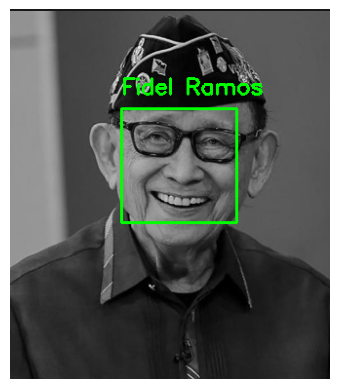

cory02.png
<class 'numpy.ndarray'>


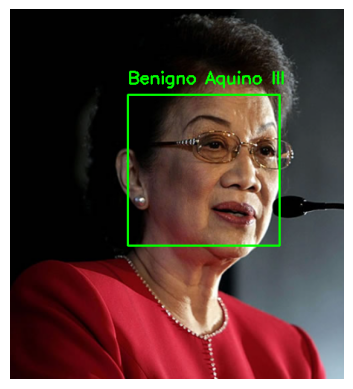

cory03.png
<class 'numpy.ndarray'>


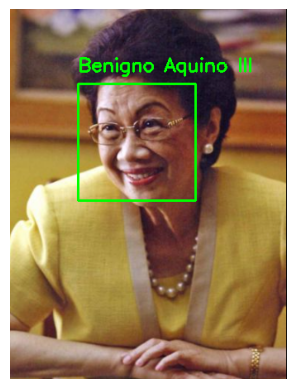

cory01.png
<class 'numpy.ndarray'>


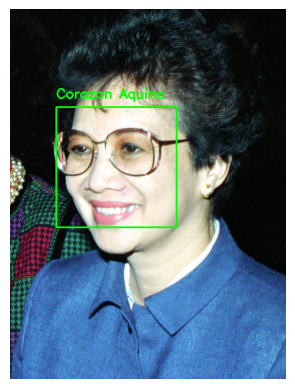

erap01.png
<class 'numpy.ndarray'>


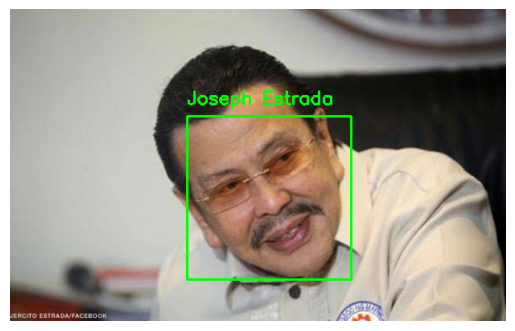

erap02.png
<class 'numpy.ndarray'>


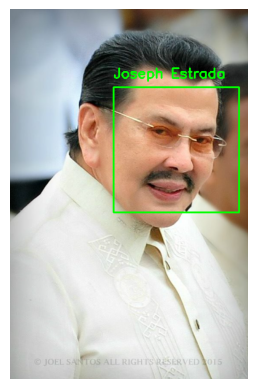

erap03.png
<class 'numpy.ndarray'>


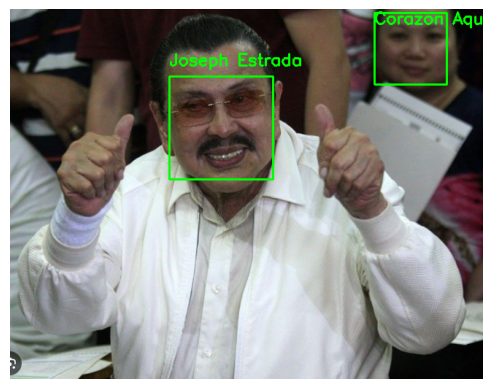

erap04.png
<class 'numpy.ndarray'>


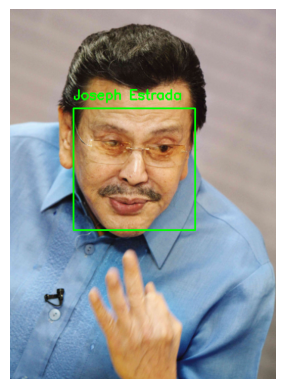

erap05.png
<class 'numpy.ndarray'>


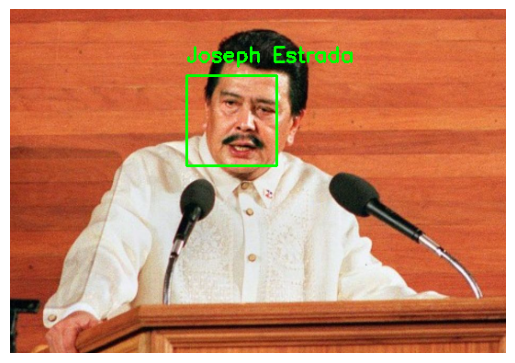

gloria01.png
<class 'numpy.ndarray'>


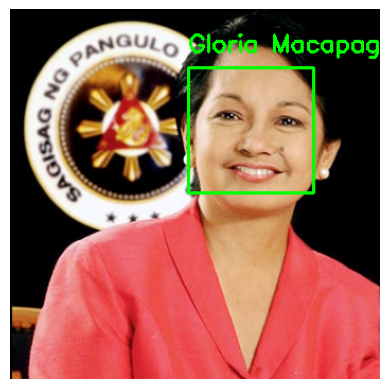

gloria02.png
<class 'numpy.ndarray'>


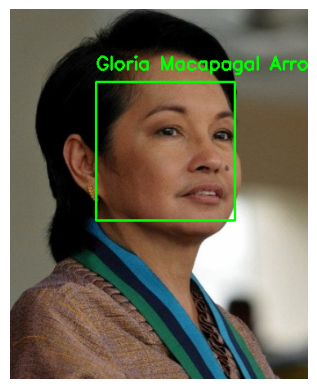

gloria03.png
<class 'numpy.ndarray'>


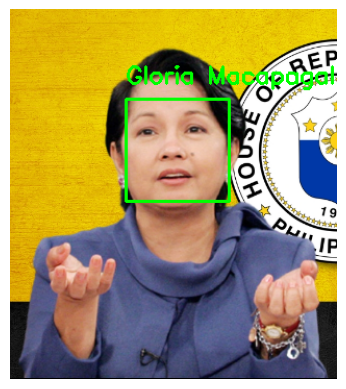

gloria04.png
<class 'numpy.ndarray'>


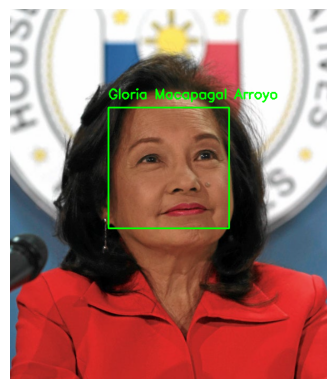

gloria05.png
<class 'numpy.ndarray'>


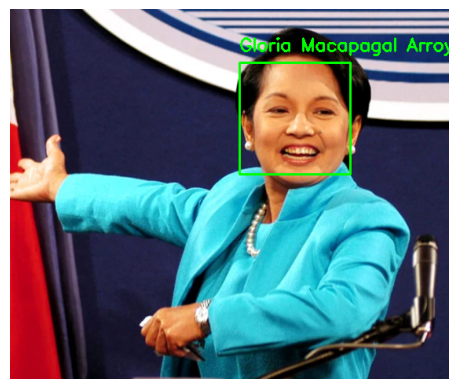

pnoy02.png
<class 'numpy.ndarray'>


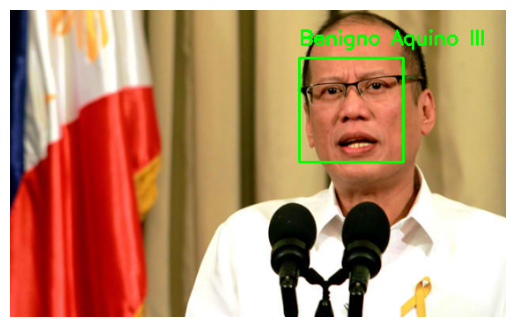

pnoy01.png
<class 'numpy.ndarray'>


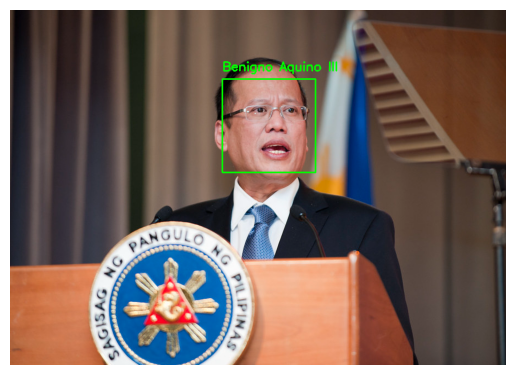

pnoy03.png
<class 'numpy.ndarray'>


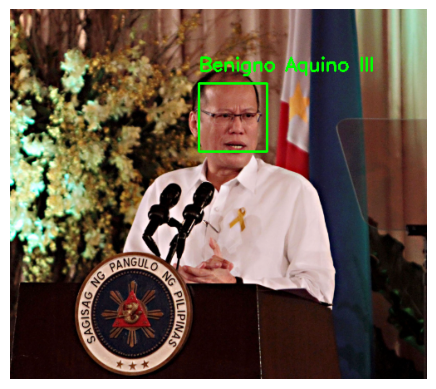

pnoy04.png
<class 'numpy.ndarray'>


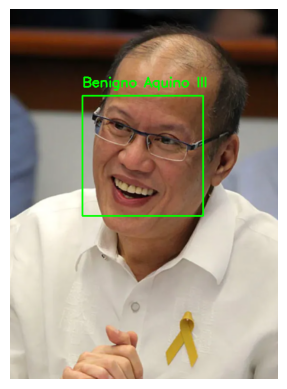

pnoy05.png
<class 'numpy.ndarray'>


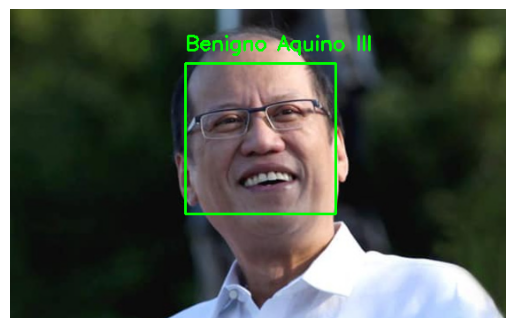

pnoy06.png
<class 'numpy.ndarray'>


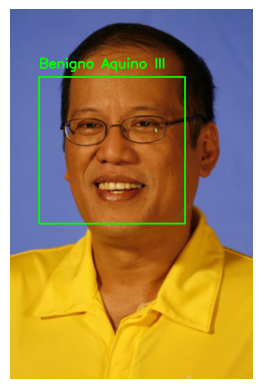

duterte01.png
<class 'numpy.ndarray'>


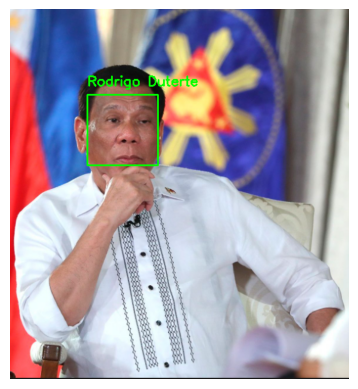

duterte02.png
<class 'numpy.ndarray'>


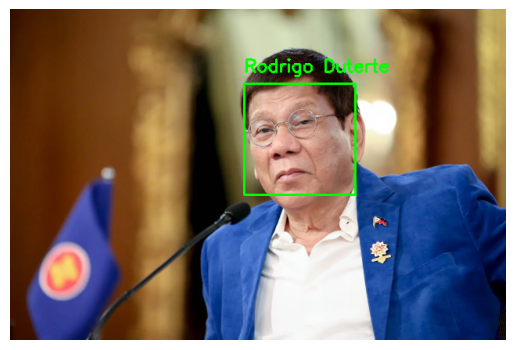

duterte03.png
<class 'numpy.ndarray'>


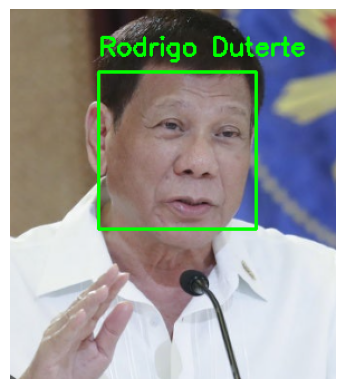

duterte04.png
<class 'numpy.ndarray'>


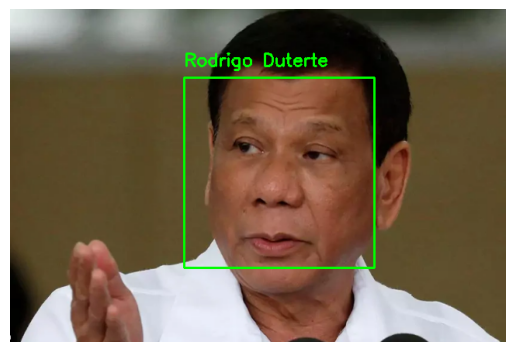

duterte05.png
<class 'numpy.ndarray'>


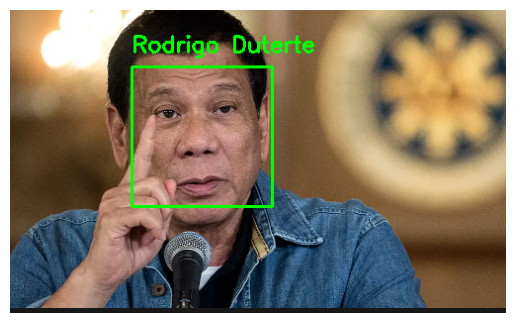

duterte06.png
<class 'numpy.ndarray'>


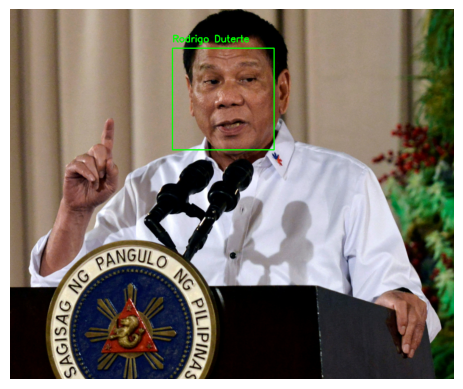

bbm01.png
<class 'numpy.ndarray'>


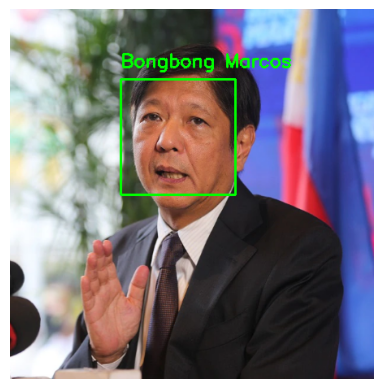

bbm02.png
<class 'numpy.ndarray'>


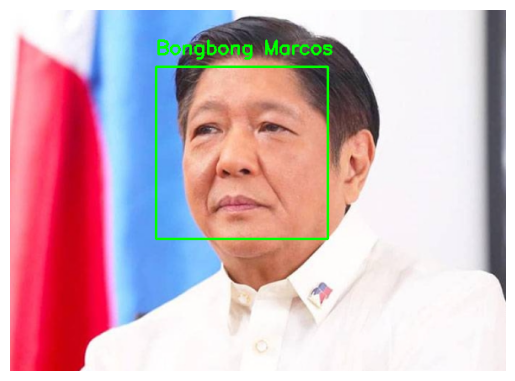

bbm03.png
<class 'numpy.ndarray'>


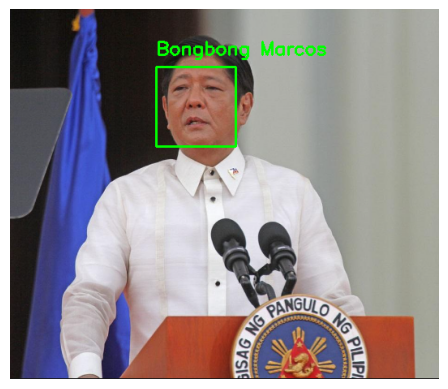

bbm04.png
<class 'numpy.ndarray'>


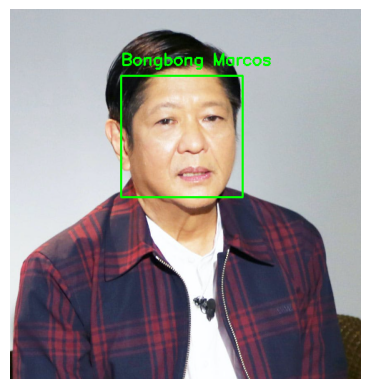

bbm05.png
<class 'numpy.ndarray'>


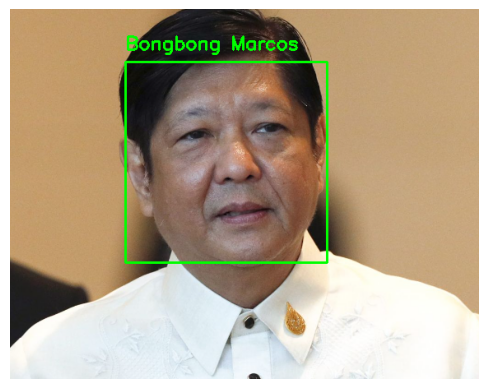

bbm06.png
<class 'numpy.ndarray'>


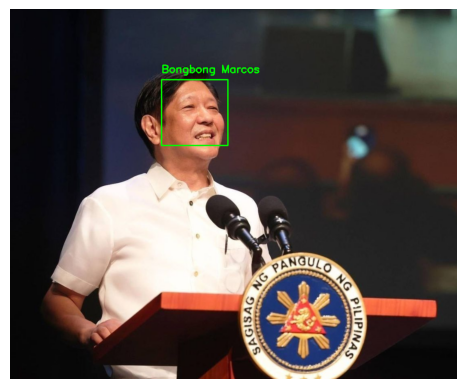

ferdinand01.png
<class 'numpy.ndarray'>


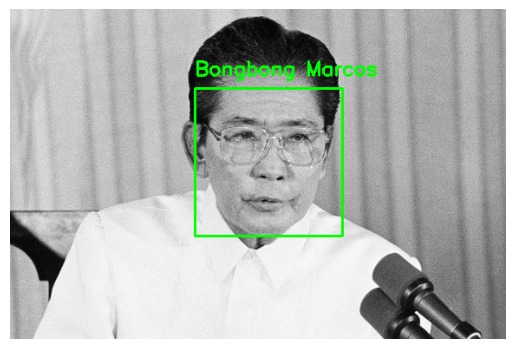

ferdinand02.png
<class 'numpy.ndarray'>


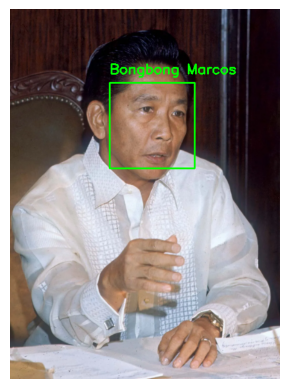

ferdinand03.png
<class 'numpy.ndarray'>


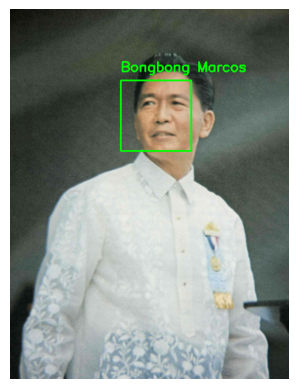

ferdinand04.png
<class 'numpy.ndarray'>


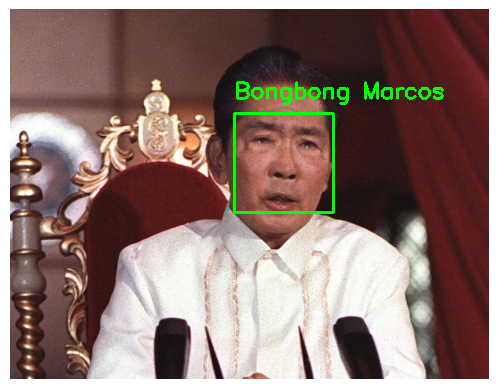

ferdinand05.png
<class 'numpy.ndarray'>


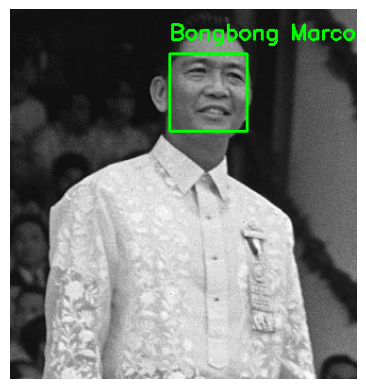

diosdado01.png
<class 'numpy.ndarray'>


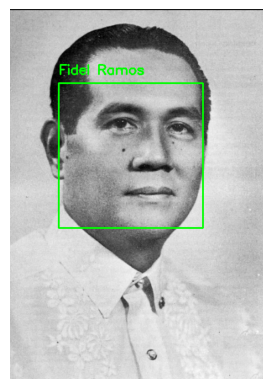

diosdado02.png
<class 'numpy.ndarray'>


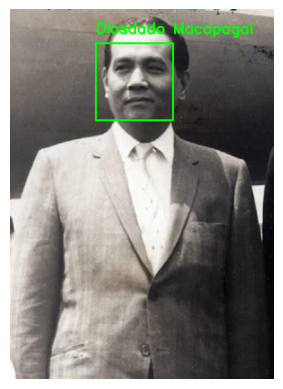

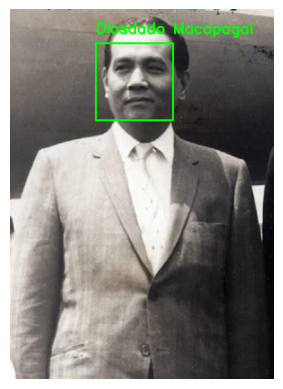

In [ ]:
questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'
local_download_path = os.path.expanduser('/content/drive/MyDrive/CS124P/Midterms/QuestionsSet')

questions = dict()


def DisplayImage(img, clear=True):
  #Display Image
  plt.imshow(img)
  plt.axis("off")
  # display the figure

  display.display(plt.gcf())
  if clear:
    display.clear_output(wait=True)

  return


checkFR = FaceRecognition()
#loop through every file in directory
for filename in os.listdir(local_download_path):
  if filename.endswith("png"):
      questions[filename] = questionImgPath + filename



for item in questions.items():
  fileName, filePath = item
  print(fileName)
  (names, img, imgName) = checkFR.GetFace(filePath)
  print(type(imgName))
  DisplayImage(imgName, False)




# **Game Class**

In [5]:


class RoundsInfo:
  wrongAns = Queue()
  wrongImg = Queue()

  def __init__(self):

    return

  def AddWrong(self, ans, img):
    self.wrongAns.put(ans)
    self.wrongImg.put(img)

    return

  def GetWrongAns(self):
    return self.wrongAns

  def GetWrongImg(self):
    return self.wrongImg


class Game:
  score = 0
  correctAnswer = ""
  choices = {"A": "" , "B": "", "C": ""} #Dictionary
  ALL_CHOICES = list()
  numRounds = 0
  FR = None
  questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'
  local_download_path = os.path.expanduser('/content/drive/MyDrive/CS124P/Midterms/QuestionsSet')
  questions = dict()
  visitedQuestion = dict() #referesh very at start of GameStart; updates every round end based on visited questions
  runInfo = None

  def __init__(self):
    self.score = 0
    self.numRounds = 5
    #self.FR = FaceRecognition()
    self.FR = KNNFaceRecognition()

    #do this on initialization; OR create dictionary on initalization
    for filename in os.listdir(self.local_download_path):
        if filename.endswith("png"):
            self.questions[filename] = self.questionImgPath + filename

    for filename in os.listdir(dataSetPath):
      self.ALL_CHOICES.append(filename)


    return


  def GameStart(self, numOfRounds):
    self.runInfo = RoundsInfo()
    display.clear_output(wait=True)

    roundCtr = 0
    self.score = 0
    self.numRounds = numOfRounds
    for x in range(self.numRounds):
      self.Round(x) #Round function here

    #Display end stats
    self.DisplayEnd()


    return

  def Round(self, roundNum):
    #initialize question, choices, correct answer

    #Generate imgPath
    imgPath = self.GetQuestion()
    (names, img, imgName) = self.FR.GetFace(imgPath)
    self.correctAnswer = names[0]
    self.choices = self.GetChoices()

    #Display questions and images
    self.DisplayRoundHeader(roundNum, img)

    #Get player input with validation
    playerAnswer = self.GetPlayerAnswer(roundNum, img)
    isCorrect = self.CheckAnswer(playerAnswer)

    if(not isCorrect):
      self.runInfo.AddWrong(self.correctAnswer, imgName)

    self.DisplayImage(imgName)
    sleep(1)

    clear_output(wait=True)
    return

  def GetChoices(self):
    temp = list()
    temp.append(self.correctAnswer) #Append correct answer to temp list
    #Get random choices
    while(len(temp) != 3):
      randInd = random.randint(0, len(self.ALL_CHOICES)-1)
      if(self.correctAnswer != self.ALL_CHOICES[randInd] and self.ALL_CHOICES[randInd] not in temp): #avoid duplicates
        temp.append(self.ALL_CHOICES[randInd])

    random.shuffle(temp)

    cntr = 0
    for let, ans in self.choices.items():
      self.choices[let] = temp[cntr]
      cntr += 1

    return self.choices #updates self.choices with choices randomized order

  def GetQuestion(self):
    isVisited = True
    while(isVisited):
      fileName, filePath = random.choice(list(self.questions.items()))
      if fileName in self.visitedQuestion:
        isVisited = True
      else:
        self.visitedQuestion[fileName] = 1
        isVisited = False

    return filePath #filePath is path of the question

  def CheckAnswer(self, playerAns):
    correctKey = self.GetKey(self.correctAnswer)
    if playerAns == correctKey:
      print("Correct answer")
      self.score += 1
      return True
    else:
      print("Wrong answer")
      return False


  def GetKey(self, ans):
    for key, value in self.choices.items():
        if ans == value:
            return key
    return "key doesn't exist"

  def GetPlayerAnswer(self, rndNum, img):
    playerAnswer = ""
    playerAnswer = input("\n\nAnswer: ").upper()

    while(playerAnswer not in ["A", "B", "C"]):
      print("Please Enter Valid Answer [A, B, C]")

      self.DisplayRoundHeader(rndNum, img)
      playerAnswer = input("\n\nAnswer: ").upper()

    return playerAnswer

  def DisplayRoundHeader(self, rndNum, img):
    #Print Round Header
    print("Question {} of {}:".format(rndNum+1, self.numRounds))
    print("Current Score {}/{}".format(self.score, self.numRounds))
    print("\nWho is this President:\n")

    #Print choices
    for let, choice in self.choices.items():
      print("{}.) {}".format(let, choice))
    print("")

    self.DisplayImage(img)
    sleep(0.5)

    return

  def DisplayImage(self, img, clear=True):
    #Display Image
    plt.imshow(img)
    plt.axis("off")
    # display the figure

    display.display(plt.gcf())
    if clear:
      display.clear_output(wait=True)

    return

  def DisplayEnd(self):
    print("\n========= FINISHED =========\n\n")
    print("Number of Rounds: {}".format(self.numRounds))
    print("Score {}/{}".format(self.score, self.numRounds))
    #Maybe show which president the player got wrong
    print("\n\n")

    print("\n====== Images You Got Wrong ======\n\n")


    #loop through queue for wrongs
    ans = self.runInfo.GetWrongAns()
    imgs = self.runInfo.GetWrongImg()

    while(not ans.empty()):
      print("")
      print(ans.get())
      self.DisplayImage(imgs.get(), False)


    input("\nPress enter to main menu...")


    return






# **Game Driver Code**

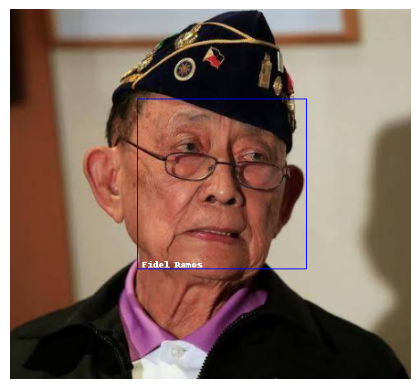

In [ ]:
G = Game()
#Game driver code
while(True):
  display.clear_output(wait=True)
  print("===== Main Menu =====")
  print("A.) Game Start")
  print("B.) Exit")

  userIn = input("Select: ").upper()
  while(userIn not in ["A", "B"]):
    userIn = input("Select: ")

  if(userIn == "A"):
    G.GameStart(5)
  elif(userIn == "B"):
    break
  else:
    print("")

display.clear_output(wait=True)


# #do this to get image
# questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'
# (names, img, imgName) = f.GetFace(questionImgPath + data[3])




# #Driver code
# imgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/cory.png'

# FR = FaceRecognition()
# (names, img, imgName) = FR.GetFace(imgPath)

# # show the output image
# cv2_imshow(img)
# #cv2_imshow(imgName)
# print(names)



# **KNN Encode**

In [ ]:
ALLOWED_EXTENSIONS = {'png', 'jpg', 'jpeg'}


def train(train_dir, model_save_path=None, n_neighbors=None, knn_algo='ball_tree', verbose=False):
    X = []
    y = []

    # Loop through each person in the training set
    for class_dir in os.listdir(train_dir):
        if not os.path.isdir(os.path.join(train_dir, class_dir)):
            continue

        # Loop through each training image for the current person
        for img_path in image_files_in_folder(os.path.join(train_dir, class_dir)):
            image = face_recognition.load_image_file(img_path)
            face_bounding_boxes = face_recognition.face_locations(image)

            if len(face_bounding_boxes) != 1:
                # If there are no people (or too many people) in a training image, skip the image.
                if verbose:
                    print("Image {} not suitable for training: {}".format(img_path, "Didn't find a face" if len(face_bounding_boxes) < 1 else "Found more than one face"))
            else:
                # Add face encoding for current image to the training set
                X.append(face_recognition.face_encodings(image, known_face_locations=face_bounding_boxes)[0])
                y.append(class_dir)

    # Determine how many neighbors to use for weighting in the KNN classifier
    if n_neighbors is None:
        n_neighbors = int(round(math.sqrt(len(X))))
        if verbose:
            print("Chose n_neighbors automatically:", n_neighbors)

    # Create and train the KNN classifier
    knn_clf = neighbors.KNeighborsClassifier(n_neighbors=n_neighbors, algorithm=knn_algo, weights='distance')
    knn_clf.fit(X, y)

    # Save the trained KNN classifier
    if model_save_path is not None:
        with open(model_save_path, 'wb') as f:
            pickle.dump(knn_clf, f)

    return knn_clf

def traintheModel(trainPath, savePath):
  print("Training KNN classifier...")
  classifier = train(trainPath, model_save_path=savePath, n_neighbors=2)
  print("Training complete!")


dataSetPath = "/content/drive/MyDrive/CS124P/Midterms/dataset"
modelPath = "/content/drive/MyDrive/CS124P/Midterms/model/trained_knn_model.clf"

traintheModel(dataSetPath, modelPath)

# **KNN Face Recognition Class**

In [6]:
# import math
# from sklearn import neighbors
# import os
# import os.path
# import pickle
# from PIL import Image, ImageDraw, ImageFont
# import face_recognition
# from face_recognition.face_recognition_cli import image_files_in_folder

In [46]:
ALLOWED_EXTENSIONS = {'png', 'jpg', 'jpeg'}


class KNNFaceRecognition:
  knn_clf = None
  modelPath = "/content/drive/MyDrive/CS124P/Midterms/model/trained_knn_model.clf"
  questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'


  def __init__(self):
    # load the trained faces through pickle.
    # Load a trained KNN model (if one was passed in)
    if self.knn_clf is None:
      with open(self.modelPath, 'rb') as f:
        self.knn_clf = pickle.load(f)



  def GetFace(self, filename, distance_threshold=0.6): #orig distance_threshold=0.6 distance_threshold: (optional) distance threshold for face classification. the larger it is, the more chance of mis-classifying an unknown person as a known one.
    if not os.path.isfile(filename) or os.path.splitext(filename)[1][1:] not in ALLOWED_EXTENSIONS:
      raise Exception("Invalid image path: {}".format(filename))

    # list for detected face
    names = []

    # Load image file and find face locations
    X_img = face_recognition.load_image_file(filename)
    X_face_locations = face_recognition.face_locations(X_img)

    # If no faces are found in the image, return an empty result.
    if len(X_face_locations) == 0:
        return []

    # Find encodings for faces in the test iamge
    faces_encodings = face_recognition.face_encodings(X_img, known_face_locations=X_face_locations)

    # Use the KNN model to find the best matches for the test face
    closest_distances = self.knn_clf.kneighbors(faces_encodings, n_neighbors=1)
    are_matches = [closest_distances[0][i][0] <= distance_threshold for i in range(len(X_face_locations))]

    # Predict classes and remove classifications that aren't within the threshold; returns prediction list tuple
    predictions = [(pred, loc) if rec else ("unknown", loc) for pred, loc, rec in zip(self.knn_clf.predict(faces_encodings), X_face_locations, are_matches)]

    pil_image = PIL.Image.open(filename).convert("RGB")
    pil_imageBox = pil_image.copy()
    draw = ImageDraw.Draw(pil_image)
    draw2 = ImageDraw.Draw(pil_imageBox)

    # fontsize = 24
    # fontss = ImageFont.truetype('/content/drive/MyDrive/CS124P/Midterms/font/LiberationMono-Regular.ttf', fontsize)

    names = []
    isFirst = False
    for name, (top, right, bottom, left) in predictions:

        if not isFirst:
          # Draw a box around the face using the Pillow module
          draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))
          draw2.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

          names.append(name)

          # There's a bug in Pillow where it blows up with non-UTF-8 text
          # when using the default bitmap font
          name = name.encode("UTF-8")

          # Draw a label with a name below the face
          draw.text((left + 6, bottom - 10), name, fill=(255, 255, 255, 255))

          isFirst = True #just get the first person

    # Remove the drawing library from memory as per the Pillow docs
    del draw
    # Display the resulting image
    #display.display(pil_image)

    return (names, pil_imageBox, pil_image) # returns name,img with box, img with name



  def GetFaceVideo(self, filename, distance_threshold=0.4):

    # list for detected face
    names = []

    # Load image file and find face locations
    X_img = cv2.cvtColor(filename, cv2.COLOR_BGR2RGB)
    X_face_locations = face_recognition.face_locations(X_img)


    # If no faces are found in the image, return an empty result.
    if len(X_face_locations) == 0: #if for some reason face is detected but face is not found here
        return (['unknown'], X_img, X_img)

    # Find encodings for faces in the test iamge
    faces_encodings = face_recognition.face_encodings(X_img, known_face_locations=X_face_locations)

    # Use the KNN model to find the best matches for the test face
    closest_distances = self.knn_clf.kneighbors(faces_encodings, n_neighbors=1)
    are_matches = [closest_distances[0][i][0] <= distance_threshold for i in range(len(X_face_locations))]

    # Predict classes and remove classifications that aren't within the threshold; returns prediction list tuple
    predictions = [(pred, loc) if rec else ("unknown", loc) for pred, loc, rec in zip(self.knn_clf.predict(faces_encodings), X_face_locations, are_matches)]




    #pil_image = Image.open(filename).convert("RGB")
    pil_image = PIL.Image.fromarray(X_img)
    pil_imageBox = pil_image.copy()
    draw = ImageDraw.Draw(pil_image)
    draw2 = ImageDraw.Draw(pil_imageBox)

    #fontsize = 24
    #font = ImageFont.truetype(r'/usr/share/fonts/truetype/liberation/LiberationMono-Regular.ttf', fontsize)


    names = []
    isFirst = False
    # fontsize = 24
    # fontss = ImageFont.truetype('/content/drive/MyDrive/CS124P/Midterms/font/LiberationMono-Regular.ttf', fontsize)

    for name, (top, right, bottom, left) in predictions:

        if not isFirst:
          # Draw a box around the face using the Pillow module
          draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))
          draw2.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

          names.append(name)
          # There's a bug in Pillow where it blows up with non-UTF-8 text
          # when using the default bitmap font
          name = name.encode("UTF-8")

          # Draw a label with a name below the face
          draw.text((left + 6, bottom - 10), name, fill=(255, 255, 255, 255))
          isFirst = True #just get the first person


    # Remove the drawing library from memory as per the Pillow docs
    del draw
    # Display the resulting image
    #display.display(pil_image)

    return (names, pil_imageBox, pil_image) # returns name,img with box, img with name


def testTheModel(testPath, modelPath):
  for image_file in os.listdir(testPath):
    full_file_path = os.path.join(testPath, image_file)

    print("Looking for faces in {}".format(image_file))

    # Find all people in the image using a trained classifier model
    # Note: You can pass in either a classifier file name or a classifier model instance
    predictions = predict(full_file_path, model_path=modelPath)

    # Print results on the console
    for name, (top, right, bottom, left) in predictions:
        print("- Found {} at ({}, {})".format(name, left, top))

    # Display results overlaid on an image
    show_prediction_labels_on_image(os.path.join(testPath, image_file), predictions)




questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/bbm01.png'

# kFR = KNNFaceRecognition()
# kFR.GetFace(questionImgPath)



#testTheModel(questionImgPath, modelPath)


# **KNN Checker**

Looking for faces in fidel01.png
names:  ['Fidel Ramos']


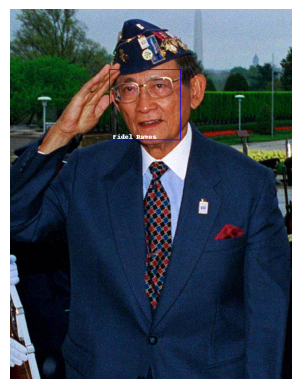

Looking for faces in fidel02.png
names:  ['Fidel Ramos']


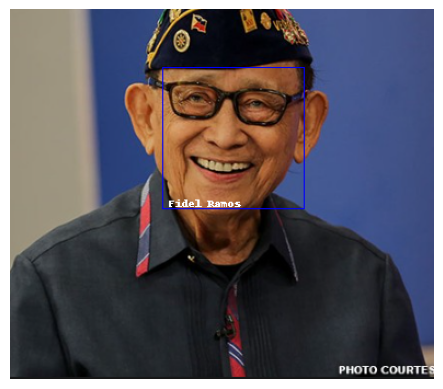

Looking for faces in cory02.png
names:  ['Corazon Aquino']


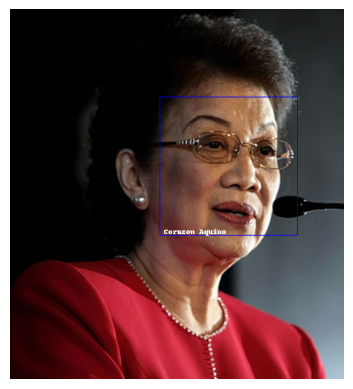

Looking for faces in cory03.png
names:  ['Corazon Aquino']


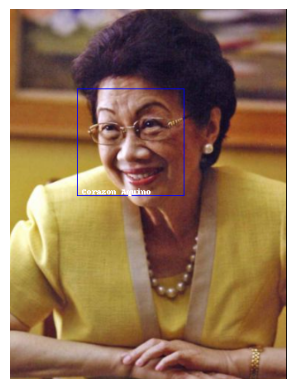

Looking for faces in cory01.png
names:  ['Corazon Aquino']


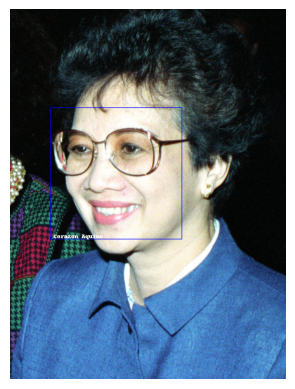

Looking for faces in erap01.png
names:  ['Joseph Estrada']


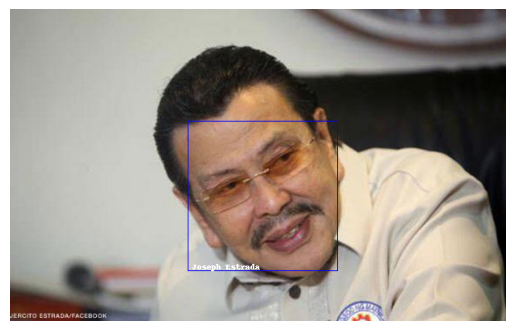

Looking for faces in erap02.png
names:  ['Joseph Estrada']


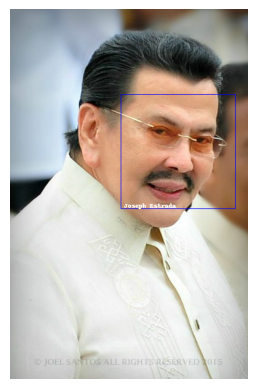

Looking for faces in erap04.png
names:  ['Joseph Estrada']


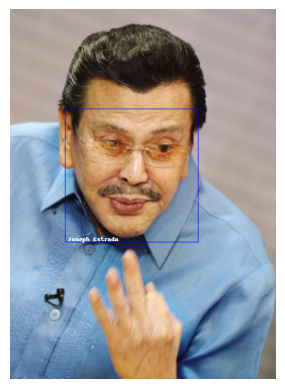

Looking for faces in erap05.png
names:  ['Joseph Estrada']


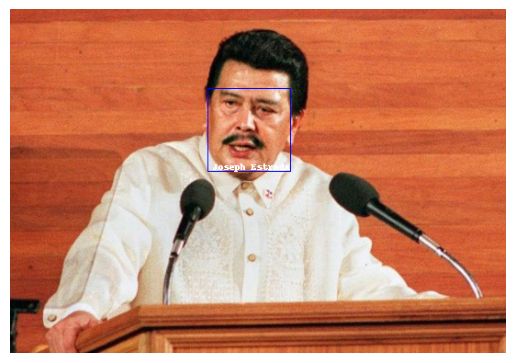

Looking for faces in gloria01.png
names:  ['Gloria Macapagal Arroyo']


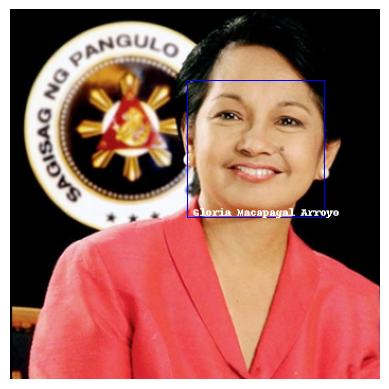

Looking for faces in gloria02.png
names:  ['Gloria Macapagal Arroyo']


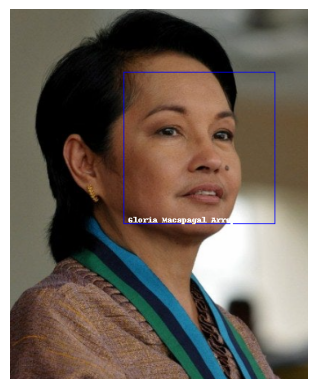

Looking for faces in gloria03.png
names:  ['Gloria Macapagal Arroyo']


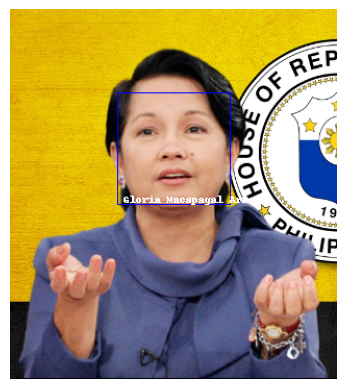

Looking for faces in gloria04.png
names:  ['Gloria Macapagal Arroyo']


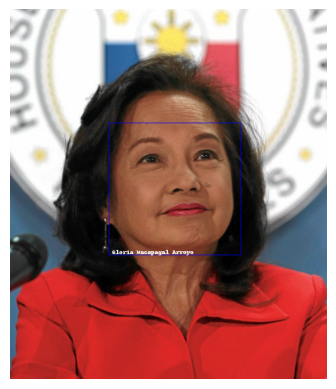

Looking for faces in gloria05.png
names:  ['Gloria Macapagal Arroyo']


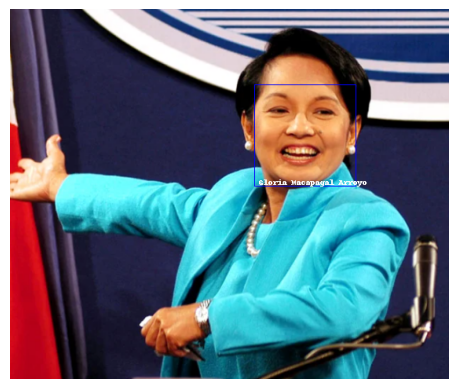

Looking for faces in pnoy02.png
names:  ['Benigno Aquino III']


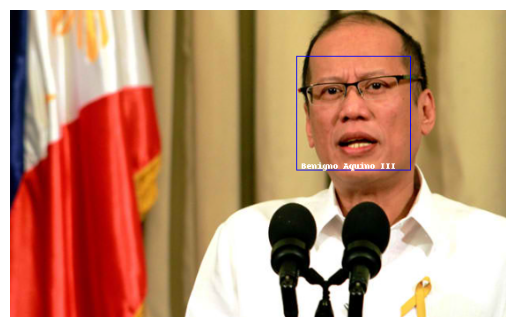

Looking for faces in pnoy01.png
names:  ['Benigno Aquino III']


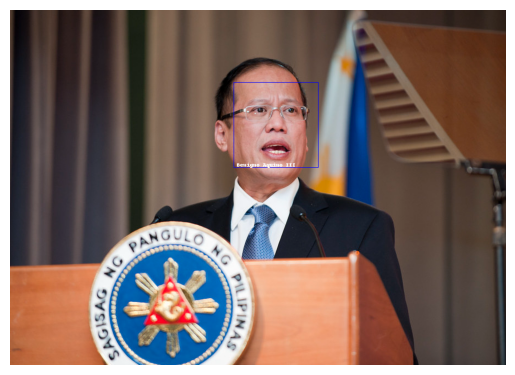

Looking for faces in pnoy03.png
names:  ['Benigno Aquino III']


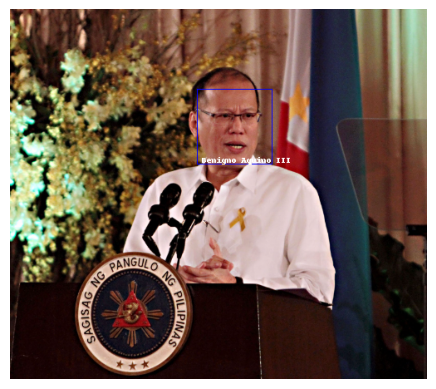

Looking for faces in pnoy04.png
names:  ['Benigno Aquino III']


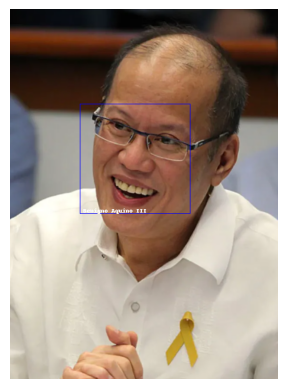

Looking for faces in pnoy05.png
names:  ['Benigno Aquino III']


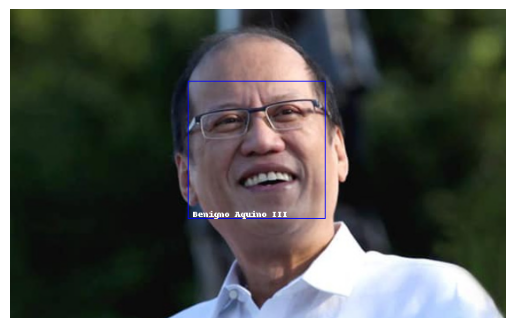

Looking for faces in pnoy06.png
names:  ['Benigno Aquino III']


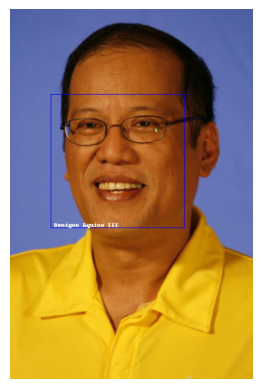

Looking for faces in duterte01.png
names:  ['Rodrigo Duterte']


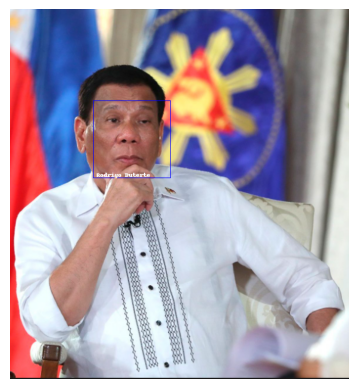

Looking for faces in duterte02.png
names:  ['Rodrigo Duterte']


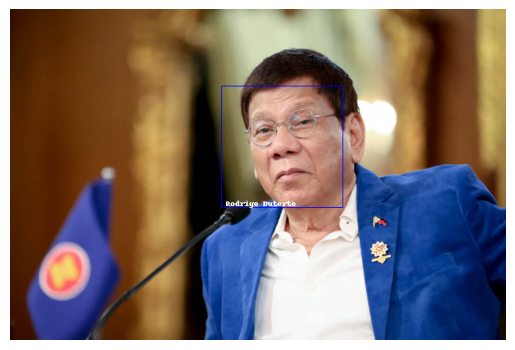

Looking for faces in duterte03.png
names:  ['Rodrigo Duterte']


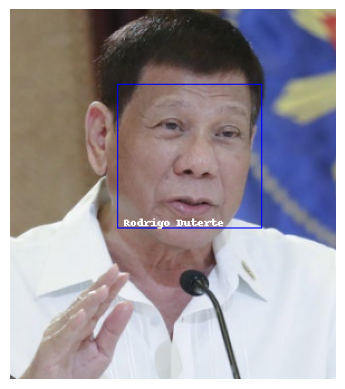

Looking for faces in duterte04.png
names:  ['Rodrigo Duterte']


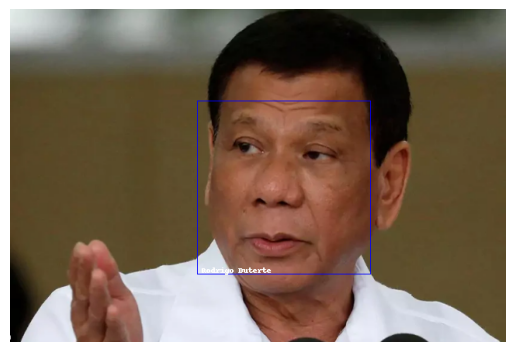

Looking for faces in duterte05.png
names:  ['Rodrigo Duterte']


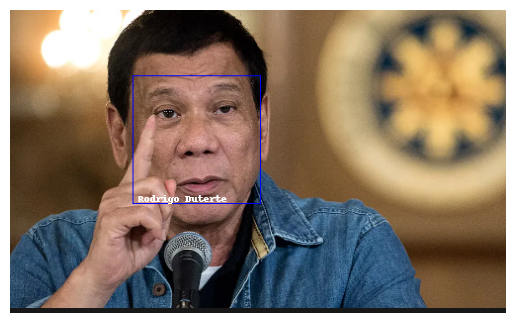

Looking for faces in duterte06.png
names:  ['Rodrigo Duterte']


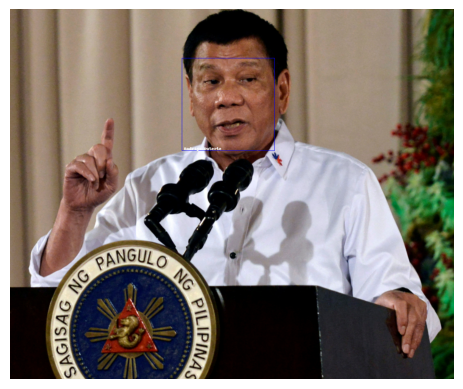

Looking for faces in bbm01.png
names:  ['Bongbong Marcos']


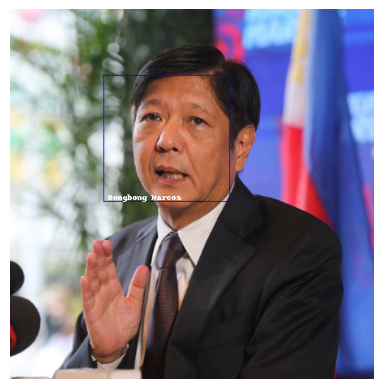

Looking for faces in bbm02.png
names:  ['Bongbong Marcos']


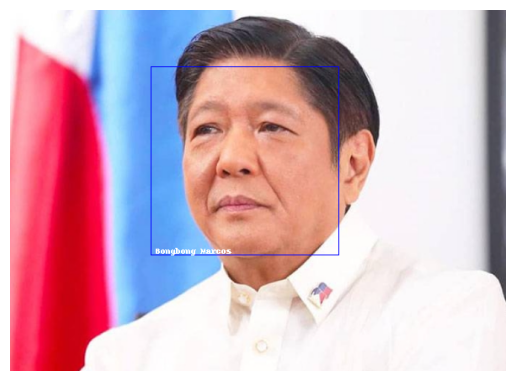

Looking for faces in bbm03.png
names:  ['Bongbong Marcos']


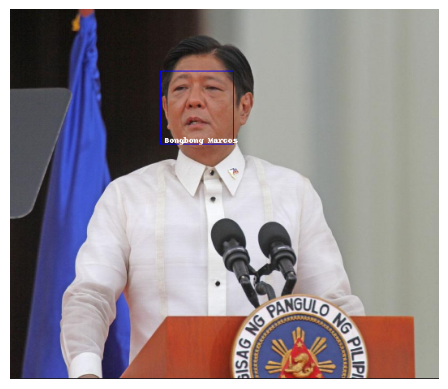

Looking for faces in bbm04.png
names:  ['Bongbong Marcos']


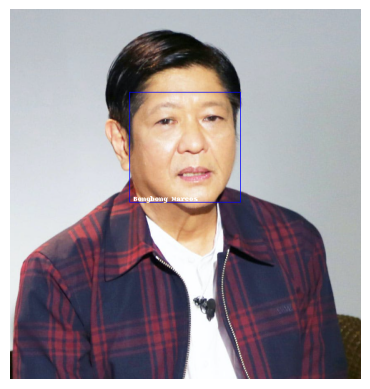

Looking for faces in bbm05.png
names:  ['Bongbong Marcos']


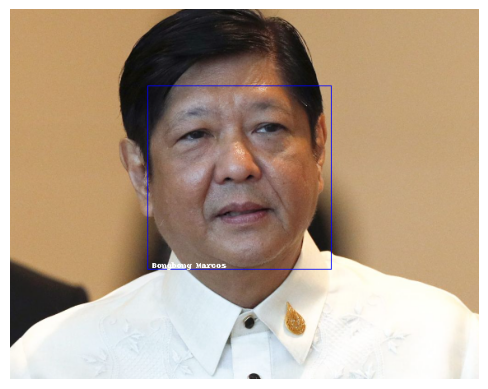

Looking for faces in bbm06.png
names:  ['Bongbong Marcos']


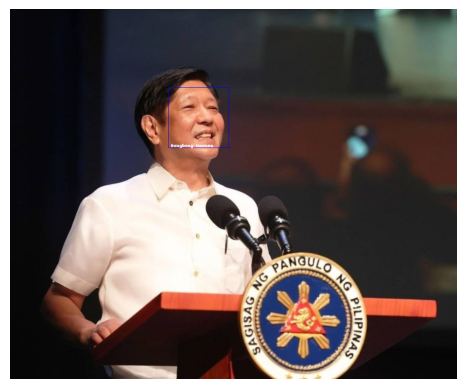

Looking for faces in ferdinand01.png
names:  ['Ferdinand Marcos']


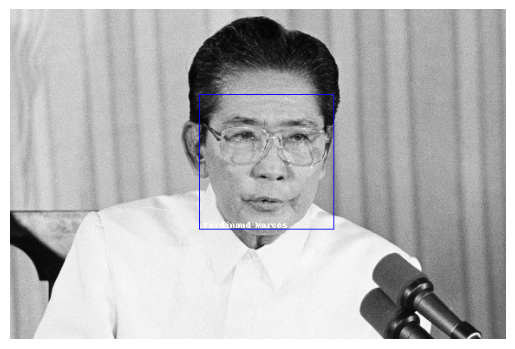

Looking for faces in ferdinand02.png
names:  ['Ferdinand Marcos']


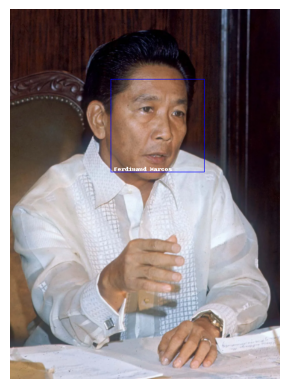

Looking for faces in ferdinand03.png
names:  ['Ferdinand Marcos']


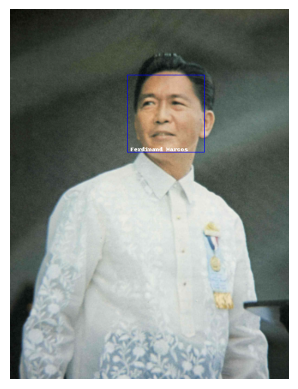

Looking for faces in ferdinand04.png
names:  ['Ferdinand Marcos']


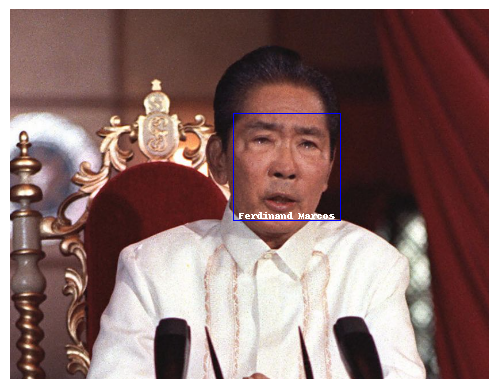

Looking for faces in ferdinand05.png
names:  ['Ferdinand Marcos']


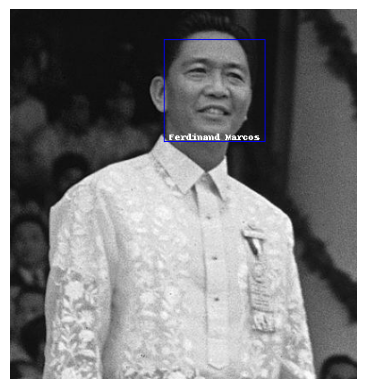

Looking for faces in diosdado01.png
names:  ['Diosdado Macapagal']


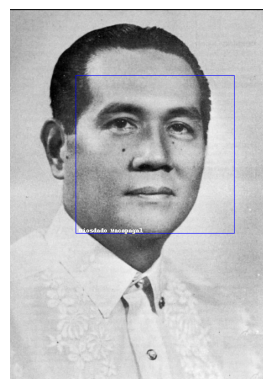

Looking for faces in diosdado02.png
names:  ['Diosdado Macapagal']


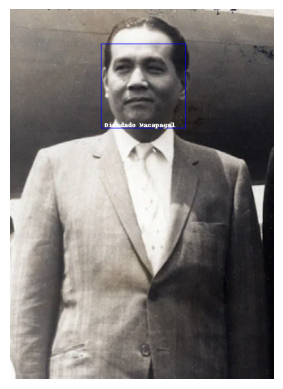

Looking for faces in erap03.png
names:  ['Joseph Estrada']


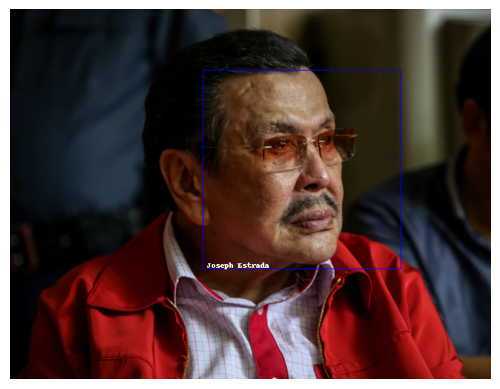

Looking for faces in fidel04.png
names:  ['Fidel Ramos']


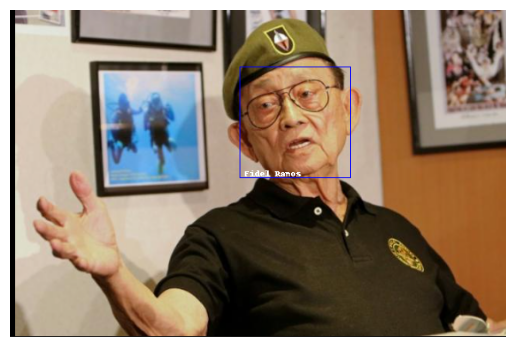

Looking for faces in fidel05.png
names:  ['Fidel Ramos']


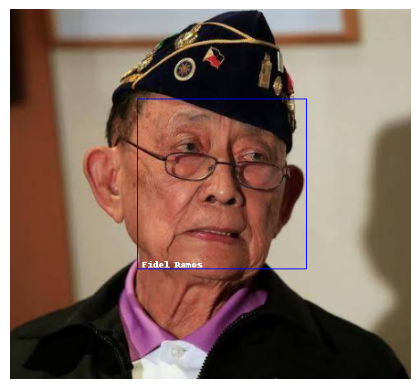

Looking for faces in fidel03.png
names:  ['Fidel Ramos']


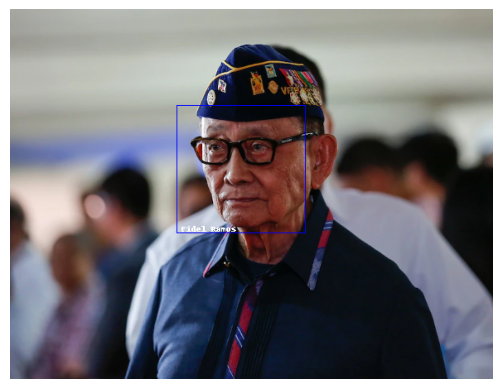

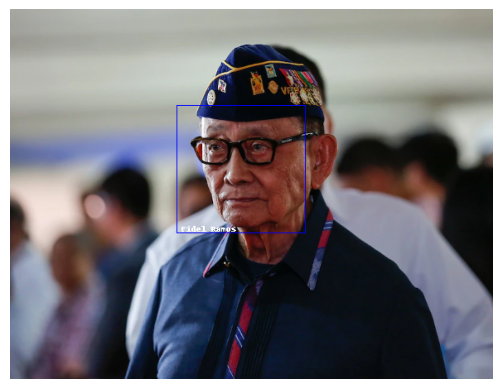

In [ ]:
#https://github.com/ageitgey/face_recognition/blob/master/examples/face_recognition_knn.py

"""
$ pip3 install scikit-learn

"""

knnFR = KNNFaceRecognition()

def testTheModel(testPath, modelPath):
  for image_file in os.listdir(testPath):
    full_file_path = os.path.join(testPath, image_file)

    print("Looking for faces in {}".format(image_file))
    (names, img, imgName) = knnFR.GetFace(os.path.join(testPath, image_file))

    print("names: ", names)
    #Display Image
    plt.imshow(imgName)
    plt.axis("off")
    # display the figure

    display(plt.gcf())

  return




modelPath = "/content/drive/MyDrive/CS124P/Midterms/model/trained_knn_model.clf"
questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'

testTheModel(questionImgPath, modelPath)


# **Web Cam**

In [ ]:
from IPython.display import display, Javascript
from google.colab.output import eval_js
from base64 import b64decode

def take_photo(filename='photo.jpg', quality=0.8):
  js = Javascript('''
    async function takePhoto(quality) {
      const div = document.createElement('div');
      const capture = document.createElement('button');
      capture.textContent = 'Capture';
      div.appendChild(capture);

      const video = document.createElement('video');
      video.style.display = 'block';
      const stream = await navigator.mediaDevices.getUserMedia({video: true});

      document.body.appendChild(div);
      div.appendChild(video);
      video.srcObject = stream;
      await video.play();

      // Resize the output to fit the video element.
      google.colab.output.setIframeHeight(document.documentElement.scrollHeight, true);

      // Wait for Capture to be clicked.
      await new Promise((resolve) => capture.onclick = resolve);

      const canvas = document.createElement('canvas');
      canvas.width = video.videoWidth;
      canvas.height = video.videoHeight;
      canvas.getContext('2d').drawImage(video, 0, 0);
      stream.getVideoTracks()[0].stop();
      div.remove();
      return canvas.toDataURL('image/jpeg', quality);
    }
    ''')
  display(js)
  data = eval_js('takePhoto({})'.format(quality))
  binary = b64decode(data.split(',')[1])
  with open(filename, 'wb') as f:
    f.write(binary)
  return filename

In [ ]:
from IPython.display import Image
try:
  filename = take_photo()
  print('Saved to {}'.format(filename))

  # Show the image which was just taken.
  display(Image(filename))
except Exception as err:
  # Errors will be thrown if the user does not have a webcam or if they do not
  # grant the page permission to access it.
  print(str(err))

# **Video Stream Capture**

In [9]:
# initialize the Haar Cascade face detection model
face_cascade = cv2.CascadeClassifier(cv2.samples.findFile(cv2.data.haarcascades + 'haarcascade_frontalface_default.xml'))

In [10]:
# function to convert the JavaScript object into an OpenCV image
def js_to_image(js_reply):
  """
  Params:
          js_reply: JavaScript object containing image from webcam
  Returns:
          img: OpenCV BGR image
  """
  # decode base64 image
  image_bytes = b64decode(js_reply.split(',')[1])
  # convert bytes to numpy array
  jpg_as_np = np.frombuffer(image_bytes, dtype=np.uint8)
  # decode numpy array into OpenCV BGR image
  img = cv2.imdecode(jpg_as_np, flags=1)

  return img

# function to convert OpenCV Rectangle bounding box image into base64 byte string to be overlayed on video stream
def bbox_to_bytes(bbox_array):
  """
  Params:
          bbox_array: Numpy array (pixels) containing rectangle to overlay on video stream.
  Returns:
        bytes: Base64 image byte string
  """
  # convert array into PIL image
  bbox_PIL = PIL.Image.fromarray(bbox_array, 'RGBA')
  iobuf = io.BytesIO()
  # format bbox into png for return
  bbox_PIL.save(iobuf, format='png')
  # format return string
  bbox_bytes = 'data:image/png;base64,{}'.format((str(b64encode(iobuf.getvalue()), 'utf-8')))

  return bbox_bytes

In [35]:
# JavaScript to properly create our live video stream using our webcam as input
def video_stream():
  js = Javascript('''
    var video;
    var div = null;
    var stream;
    var captureCanvas;
    var imgElement;
    var labelElement;

    var pendingResolve = null;
    var shutdown = false;

    function removeDom() {
       stream.getVideoTracks()[0].stop();
       video.remove();
       div.remove();
       video = null;
       div = null;
       stream = null;
       imgElement = null;
       captureCanvas = null;
       labelElement = null;
    }

    function onAnimationFrame() {
      if (!shutdown) {
        window.requestAnimationFrame(onAnimationFrame);
      }
      if (pendingResolve) {
        var result = "";
        if (!shutdown) {
          captureCanvas.getContext('2d').drawImage(video, 0, 0, 640, 480);
          result = captureCanvas.toDataURL('image/jpeg', 0.8)
        }
        var lp = pendingResolve;
        pendingResolve = null;
        lp(result);
      }
    }

    async function createDom() {
      if (div !== null) {
        return stream;
      }

      div = document.createElement('div');
      div.style.border = '2px solid black';
      div.style.padding = '3px';
      div.style.width = '100%';
      div.style.maxWidth = '600px';
      document.body.appendChild(div);

      const modelOut = document.createElement('div');
      modelOut.innerHTML = "<span>Status:</span>";
      labelElement = document.createElement('span');
      labelElement.innerText = 'No data';
      labelElement.style.fontWeight = 'bold';
      modelOut.appendChild(labelElement);
      div.appendChild(modelOut);

      video = document.createElement('video');
      video.style.display = 'block';
      video.width = div.clientWidth - 6;
      video.setAttribute('playsinline', '');
      video.onclick = () => { shutdown = true; };
      stream = await navigator.mediaDevices.getUserMedia(
          {video: { facingMode: "environment"}});
      div.appendChild(video);

      imgElement = document.createElement('img');
      imgElement.style.position = 'absolute';
      imgElement.style.zIndex = 1;
      imgElement.onclick = () => { shutdown = true; };
      div.appendChild(imgElement);

      const instruction = document.createElement('div');
      instruction.innerHTML =
          '<span style="color: red; font-weight: bold;">' +
          'When finished, click here or on the video to stop this demo</span>';
      div.appendChild(instruction);
      instruction.onclick = () => { shutdown = true; };

      video.srcObject = stream;
      await video.play();

      captureCanvas = document.createElement('canvas');
      captureCanvas.width = 640; //video.videoWidth;
      captureCanvas.height = 480; //video.videoHeight;
      window.requestAnimationFrame(onAnimationFrame);

      return stream;
    }
    async function stream_frame(label, imgData) {
      if (shutdown) {
        removeDom();
        shutdown = false;
        return '';
      }

      var preCreate = Date.now();
      stream = await createDom();

      var preShow = Date.now();
      if (label != "") {
        labelElement.innerHTML = label;
      }

      if (imgData != "") {
        var videoRect = video.getClientRects()[0];
        imgElement.style.top = videoRect.top + "px";
        imgElement.style.left = videoRect.left + "px";
        imgElement.style.width = videoRect.width + "px";
        imgElement.style.height = videoRect.height + "px";
        imgElement.src = imgData;
      }

      var preCapture = Date.now();
      var result = await new Promise(function(resolve, reject) {
        pendingResolve = resolve;
      });
      shutdown = false;

      return {'create': preShow - preCreate,
              'show': preCapture - preShow,
              'capture': Date.now() - preCapture,
              'img': result};
    }
    ''')

  display(js)

def video_frame(label, bbox):
  data = eval_js('stream_frame("{}", "{}")'.format(label, bbox))
  return data

def stop_video(): #it worked
  eval_js('removeDom()')
  return

# **Video Stream Driver Code**

clear clear clear
Rodrigo Duterte


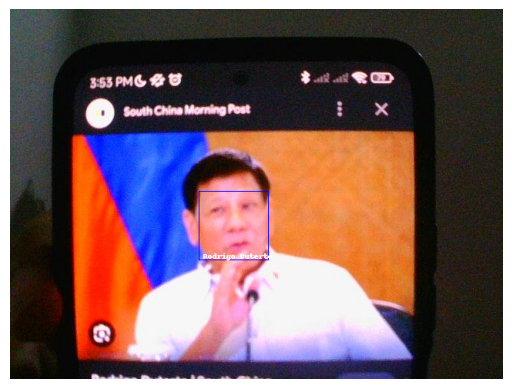

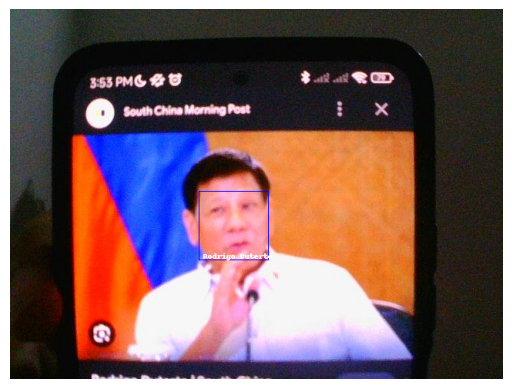

In [47]:
# start streaming video from webcam
video_stream()
# label for video
label_html = 'Capturing...'
# initialze bounding box to empty
bbox = ''
count = 0

#fr = FaceRecognition()
fr = KNNFaceRecognition()

isSecondCheck = 0 #to atleast capture the same for 2 frames

while True:
    clear_output(wait=True)

    js_reply = video_frame(label_html, bbox)
    if not js_reply:
        break

    # convert JS response to OpenCV Image
    img = js_to_image(js_reply["img"])

    # create transparent overlay for bounding box
    bbox_array = np.zeros([480,640,4], dtype=np.uint8)

    # grayscale image for face detection
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)

    # get face region coordinates
    faces = face_cascade.detectMultiScale(gray)

    #print("test {}".format(count))
    #count += 1

    # get face bounding box for overlay
    # for (x,y,w,h) in faces:
    #   bbox_array = cv2.rectangle(bbox_array,(x,y),(x+w,y+h),(255,0,0),2)



    # Detect Face
    if len(faces) == 0:
      print("no faces found")
      isSecondCheck = 0
    else:
      (name, imgFr, imgName) = fr.GetFaceVideo(img)
      (x,y,w,h) = faces[0]

      if(name[0].lower() != "unknown"): #check if face is known
        print(name[0])
        bbox_array = cv2.rectangle(bbox_array,(x,y),(x+w,y+h),(255,0,0),2)
        isSecondCheck += 1
        if isSecondCheck == 1:
          break
      else:
        #face found is unknown
        isSecondCheck = 0
        print(name[0].lower())
        bbox_array = cv2.rectangle(bbox_array,(x,y),(x+w,y+h),(255,0,0),2)



    bbox_array[:,:,3] = (bbox_array.max(axis = 2) > 0 ).astype(int) * 255
    # convert overlay of bbox into bytes
    bbox_bytes = bbox_to_bytes(bbox_array)
    # update bbox so next frame gets new overlay
    bbox = bbox_bytes


stop_video()


clear_output(wait=True)
print("clear clear clear")

#after breaking meaning... face has been found and yea
print(name[0])
plt.imshow(imgName)
plt.axis("off")
# display the figure
display(plt.gcf())







# **[tester] KNN Face Recognition**


In [ ]:
!pip3 install scikit-learn

## **KNN Import**

In [ ]:

import math
from sklearn import neighbors
import os
import os.path
import pickle
from PIL import Image, ImageDraw
import face_recognition
from face_recognition.face_recognition_cli import image_files_in_folder


## **KNN Encode**

In [ ]:
ALLOWED_EXTENSIONS = {'png', 'jpg', 'jpeg'}


def train(train_dir, model_save_path=None, n_neighbors=None, knn_algo='ball_tree', verbose=False):
    """
    Trains a k-nearest neighbors classifier for face recognition.

    :param train_dir: directory that contains a sub-directory for each known person, with its name.

     (View in source code to see train_dir example tree structure)

     Structure:
        <train_dir>/
        ├── <person1>/
        │   ├── <somename1>.jpeg
        │   ├── <somename2>.jpeg
        │   ├── ...
        ├── <person2>/
        │   ├── <somename1>.jpeg
        │   └── <somename2>.jpeg
        └── ...

    :param model_save_path: (optional) path to save model on disk
    :param n_neighbors: (optional) number of neighbors to weigh in classification. Chosen automatically if not specified
    :param knn_algo: (optional) underlying data structure to support knn.default is ball_tree
    :param verbose: verbosity of training
    :return: returns knn classifier that was trained on the given data.
    """
    X = []
    y = []

    # Loop through each person in the training set
    for class_dir in os.listdir(train_dir):
        if not os.path.isdir(os.path.join(train_dir, class_dir)):
            continue

        # Loop through each training image for the current person
        for img_path in image_files_in_folder(os.path.join(train_dir, class_dir)):
            image = face_recognition.load_image_file(img_path)
            face_bounding_boxes = face_recognition.face_locations(image)

            if len(face_bounding_boxes) != 1:
                # If there are no people (or too many people) in a training image, skip the image.
                if verbose:
                    print("Image {} not suitable for training: {}".format(img_path, "Didn't find a face" if len(face_bounding_boxes) < 1 else "Found more than one face"))
            else:
                # Add face encoding for current image to the training set
                X.append(face_recognition.face_encodings(image, known_face_locations=face_bounding_boxes)[0])
                y.append(class_dir)

    # Determine how many neighbors to use for weighting in the KNN classifier
    if n_neighbors is None:
        n_neighbors = int(round(math.sqrt(len(X))))
        if verbose:
            print("Chose n_neighbors automatically:", n_neighbors)

    # Create and train the KNN classifier
    knn_clf = neighbors.KNeighborsClassifier(n_neighbors=n_neighbors, algorithm=knn_algo, weights='distance')
    knn_clf.fit(X, y)

    # Save the trained KNN classifier
    if model_save_path is not None:
        with open(model_save_path, 'wb') as f:
            pickle.dump(knn_clf, f)

    return knn_clf

def traintheModel(trainPath, savePath):
  print("Training KNN classifier...")
  classifier = train(trainPath, model_save_path=savePath, n_neighbors=2)
  print("Training complete!")


dataSetPath = "/content/drive/MyDrive/CS124P/Midterms/dataset"
modelPath = "/content/drive/MyDrive/CS124P/Midterms/model/trained_knn_model.clf"

traintheModel(dataSetPath, modelPath)

Training KNN classifier...
Training complete!


## **KNN Checker**

Looking for faces in fidel01.png
- Found Fidel Ramos at (151, 92)
b'Fidel Ramos'


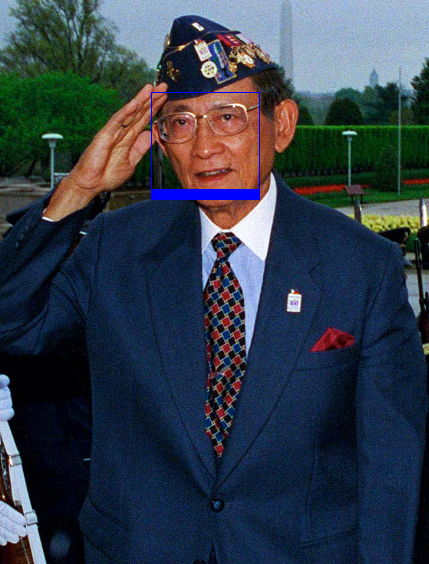

Looking for faces in fidel02.png
- Found Fidel Ramos at (139, 53)
b'Fidel Ramos'


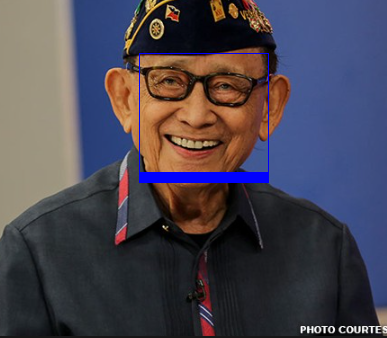

Looking for faces in fidel03.png
- Found Fidel Ramos at (98, 98)
b'Fidel Ramos'


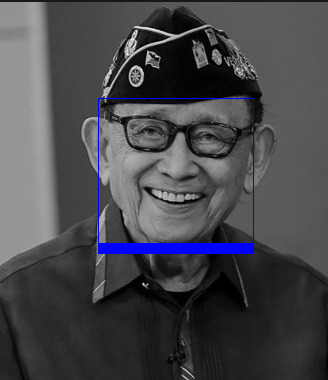

Looking for faces in cory02.png
- Found Corazon Aquino at (201, 118)
b'Corazon Aquino'


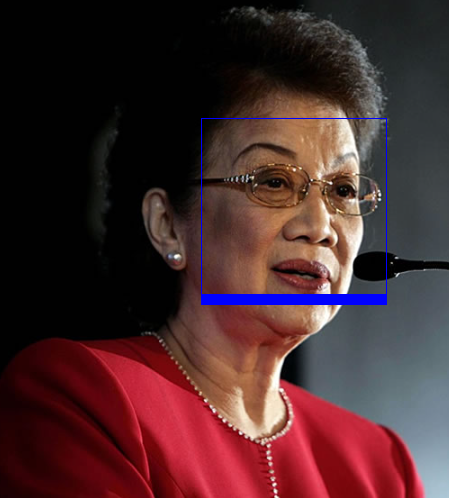

Looking for faces in cory03.png
- Found Corazon Aquino at (81, 96)
b'Corazon Aquino'


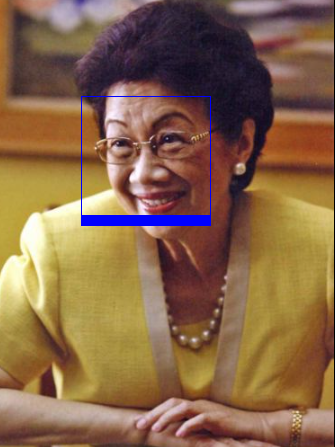

Looking for faces in cory01.png
- Found Corazon Aquino at (68, 167)
b'Corazon Aquino'


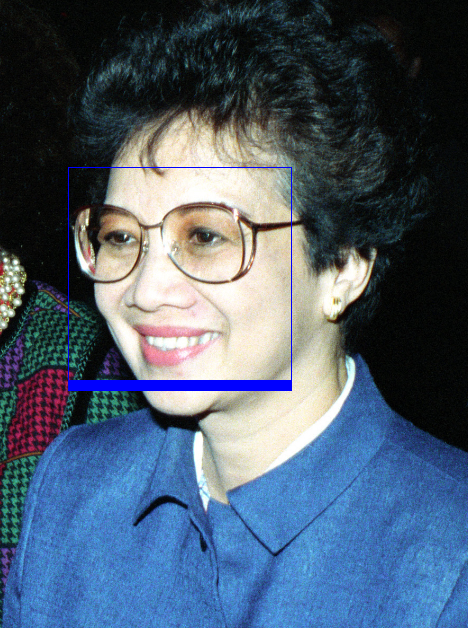

Looking for faces in erap01.png
- Found Joseph Estrada at (221, 139)
b'Joseph Estrada'


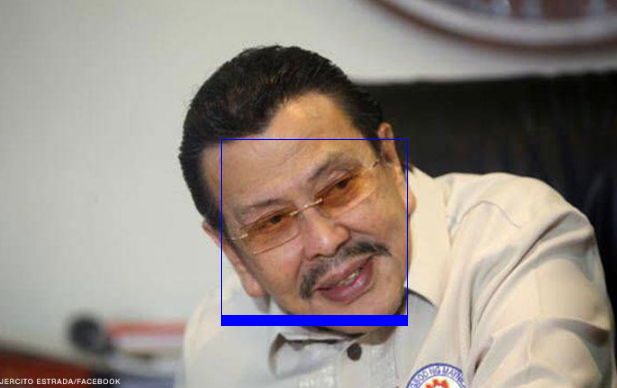

Looking for faces in erap02.png
- Found Joseph Estrada at (180, 139)
b'Joseph Estrada'


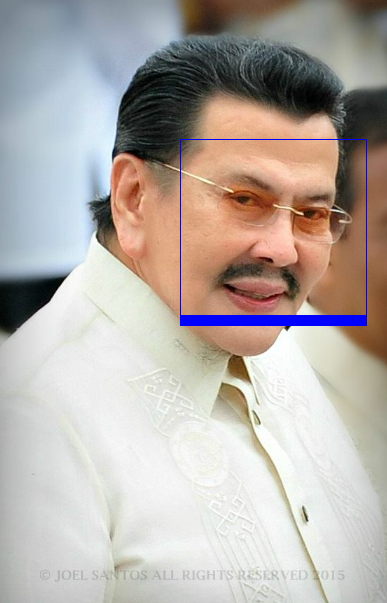

Looking for faces in erap03.png
- Found Corazon Aquino at (497, 8)
- Found Joseph Estrada at (218, 81)
b'Joseph Estrada'


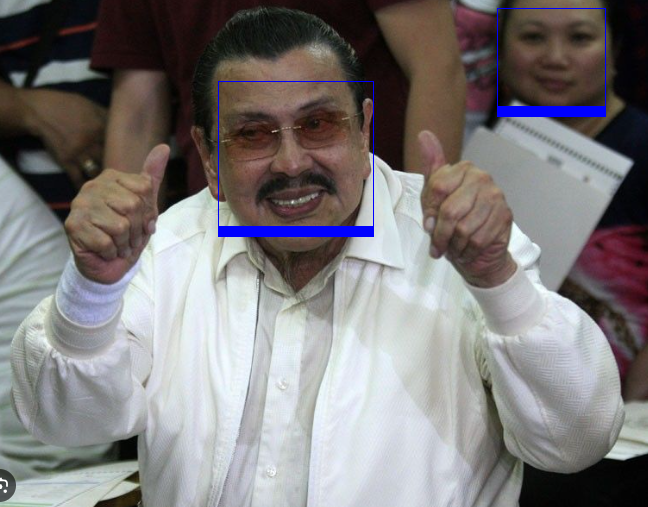

Looking for faces in erap04.png
- Found Joseph Estrada at (92, 167)
b'Joseph Estrada'


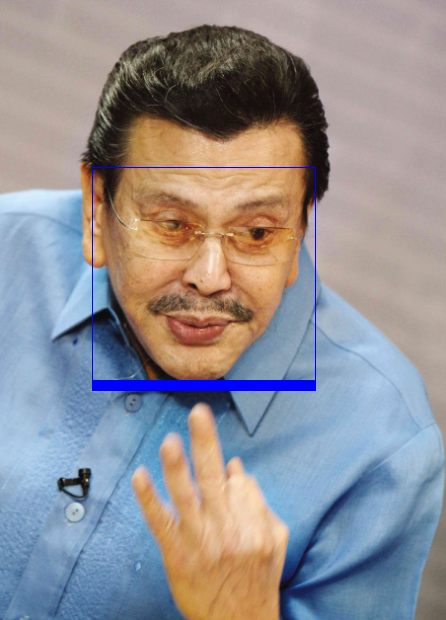

Looking for faces in erap05.png
- Found Joseph Estrada at (215, 86)
b'Joseph Estrada'


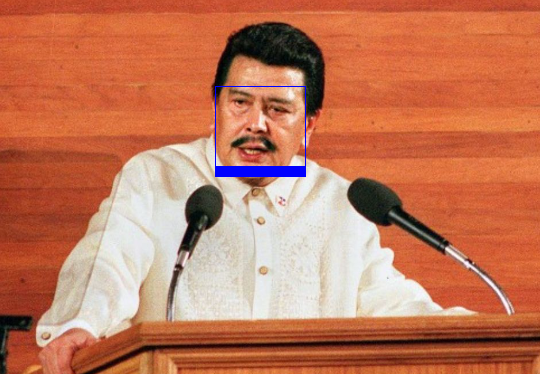

Looking for faces in gloria01.png
- Found Gloria Macapagal Arroyo at (167, 67)
b'Gloria Macapagal Arroyo'


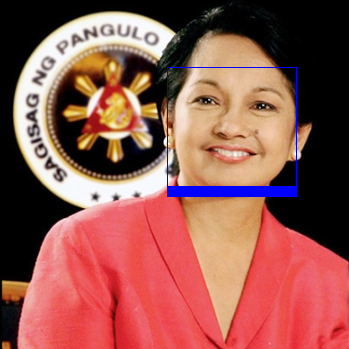

Looking for faces in gloria02.png
- Found Gloria Macapagal Arroyo at (139, 77)
b'Gloria Macapagal Arroyo'


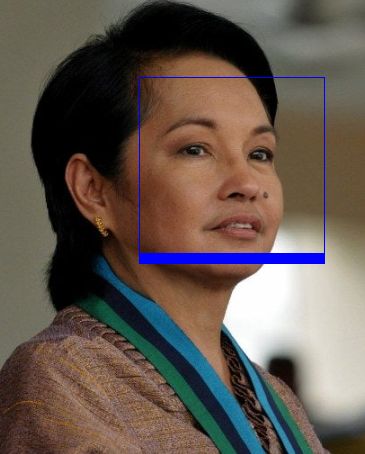

Looking for faces in gloria03.png
- Found Gloria Macapagal Arroyo at (103, 80)
b'Gloria Macapagal Arroyo'


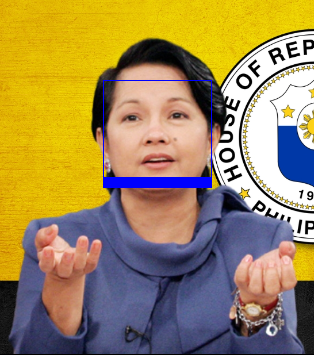

Looking for faces in gloria04.png
- Found Gloria Macapagal Arroyo at (167, 192)
b'Gloria Macapagal Arroyo'


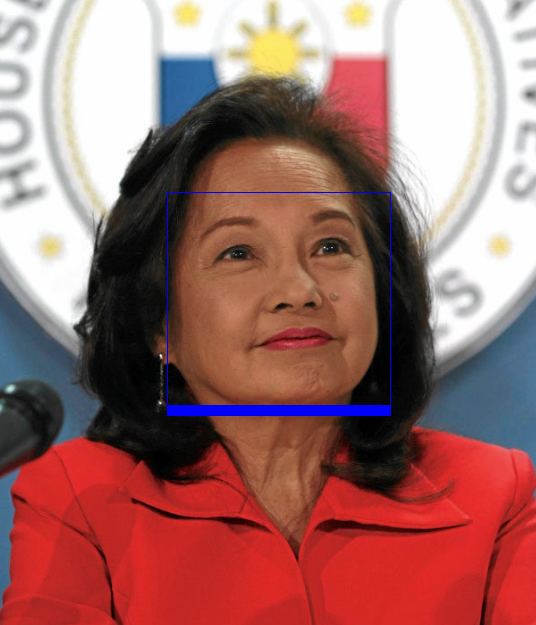

Looking for faces in gloria05.png
- Found Gloria Macapagal Arroyo at (311, 96)
b'Gloria Macapagal Arroyo'


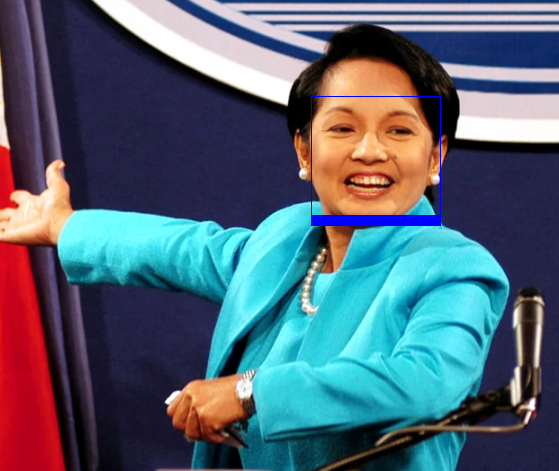

Looking for faces in pnoy02.png
- Found Benigno Aquino III at (325, 53)
b'Benigno Aquino III'


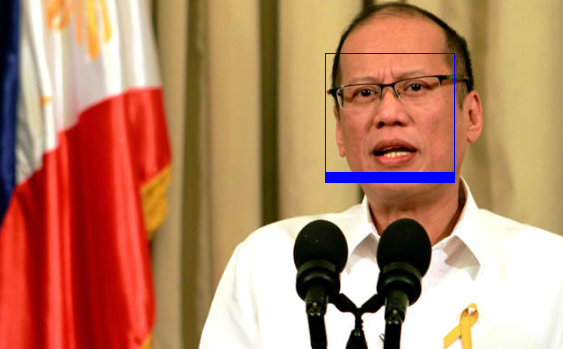

Looking for faces in pnoy01.png
- Found Benigno Aquino III at (408, 133)
b'Benigno Aquino III'


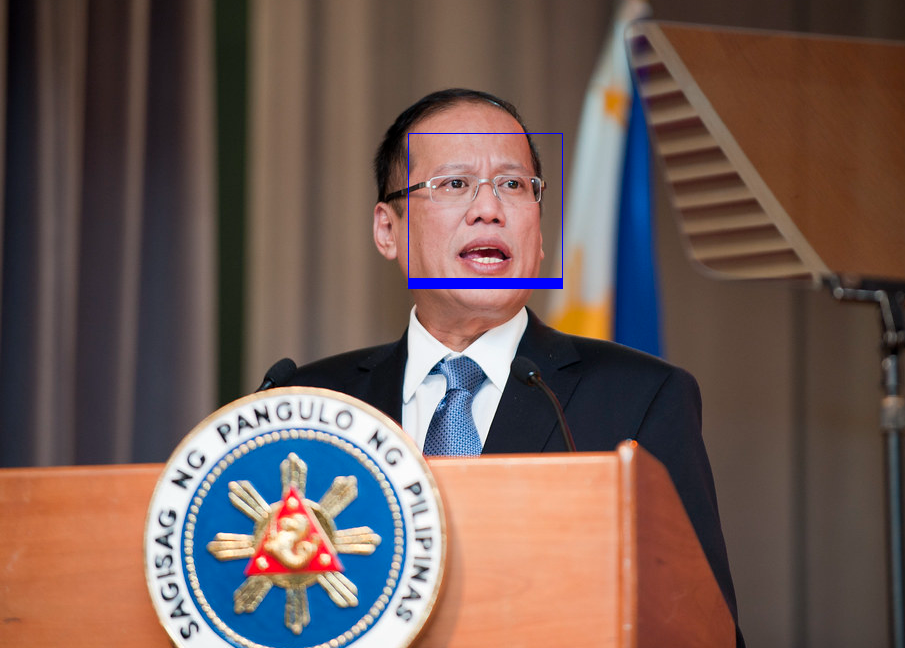

Looking for faces in pnoy03.png
- Found Benigno Aquino III at (225, 96)
b'Benigno Aquino III'


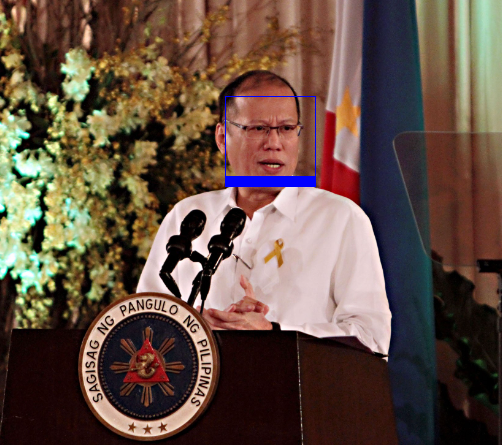

Looking for faces in pnoy04.png
- Found Benigno Aquino III at (118, 160)
b'Benigno Aquino III'


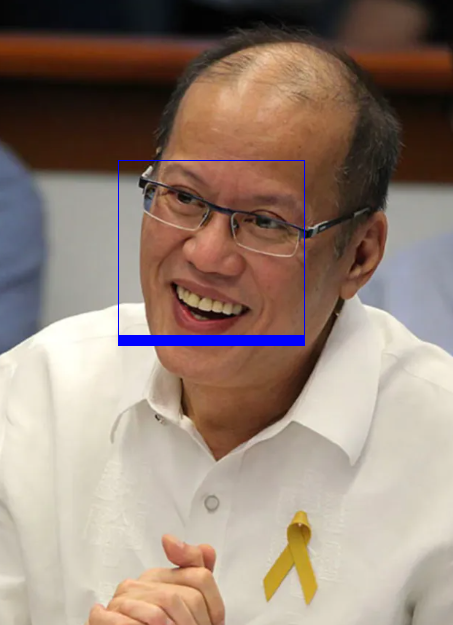

Looking for faces in pnoy05.png
- Found Benigno Aquino III at (201, 81)
b'Benigno Aquino III'


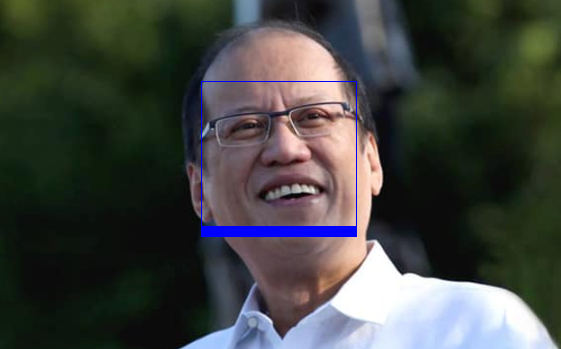

Looking for faces in pnoy06.png
- Found Benigno Aquino III at (68, 142)
b'Benigno Aquino III'


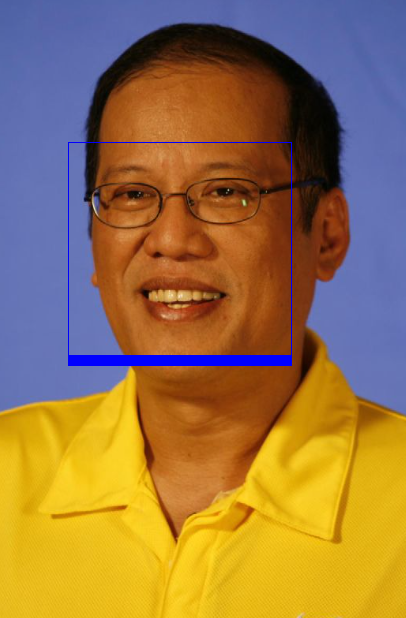

Looking for faces in duterte01.png
- Found Rodrigo Duterte at (139, 153)
b'Rodrigo Duterte'


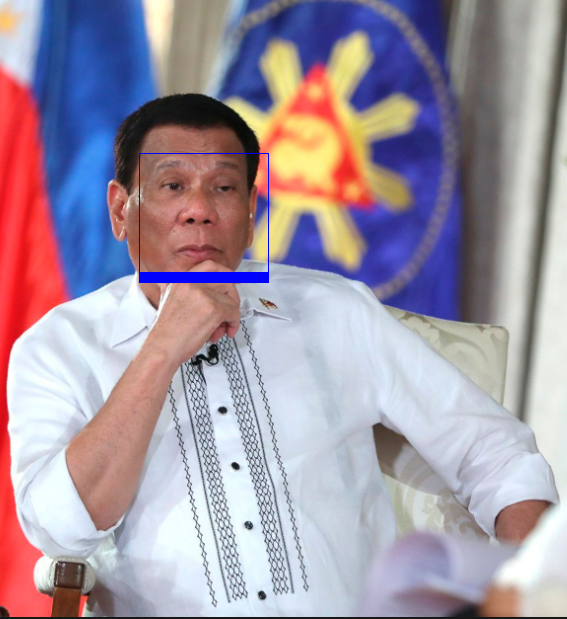

Looking for faces in duterte02.png
- Found Rodrigo Duterte at (270, 98)
b'Rodrigo Duterte'


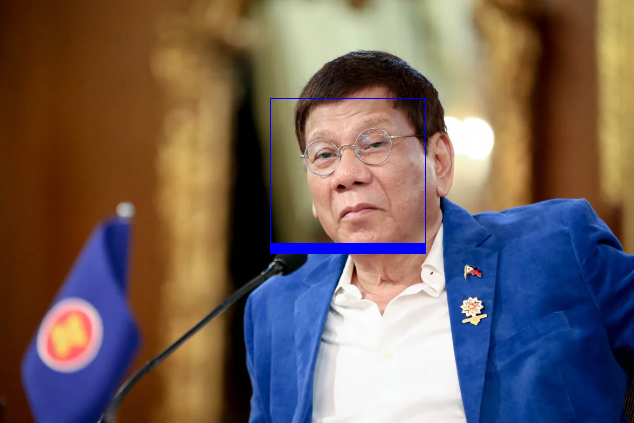

Looking for faces in duterte03.png
- Found Rodrigo Duterte at (96, 67)
b'Rodrigo Duterte'


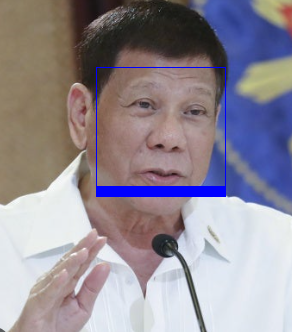

Looking for faces in duterte04.png
- Found Rodrigo Duterte at (241, 118)
b'Rodrigo Duterte'


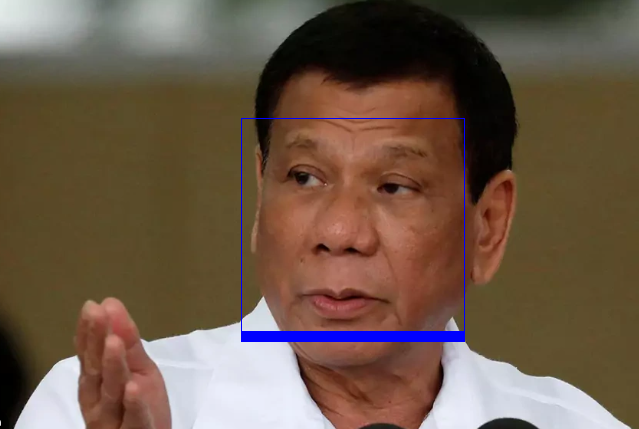

Looking for faces in duterte05.png
- Found Rodrigo Duterte at (124, 67)
b'Rodrigo Duterte'


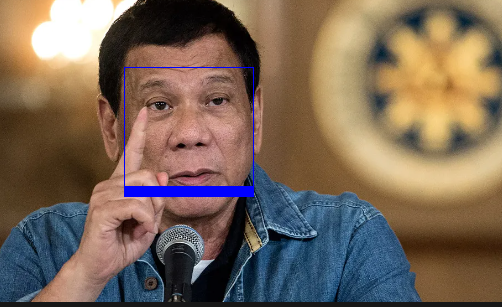

Looking for faces in duterte06.png
- Found Rodrigo Duterte at (414, 118)
b'Rodrigo Duterte'


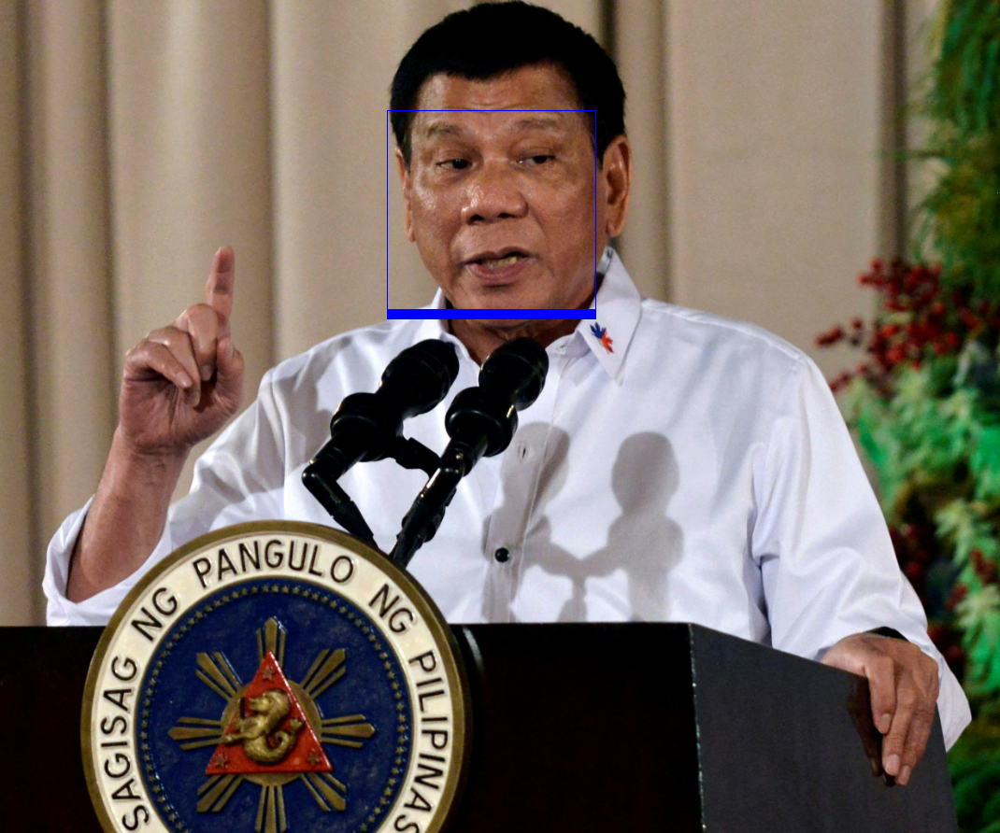

Looking for faces in bbm01.png
- Found Bongbong Marcos at (115, 81)
b'Bongbong Marcos'


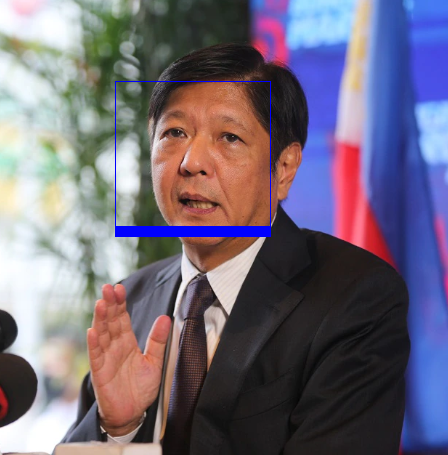

Looking for faces in bbm02.png
- Found Bongbong Marcos at (167, 68)
b'Bongbong Marcos'


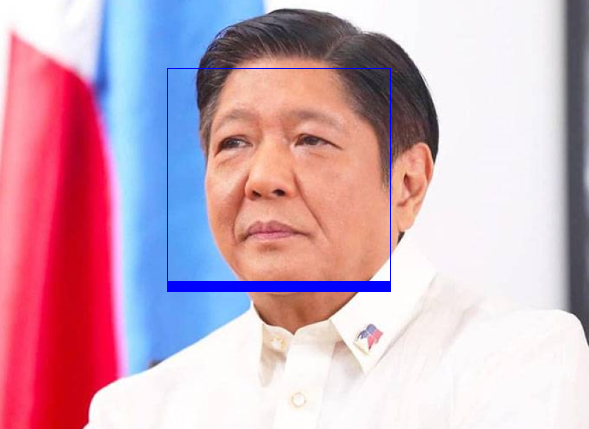

Looking for faces in bbm03.png
- Found Bongbong Marcos at (185, 76)
b'Bongbong Marcos'


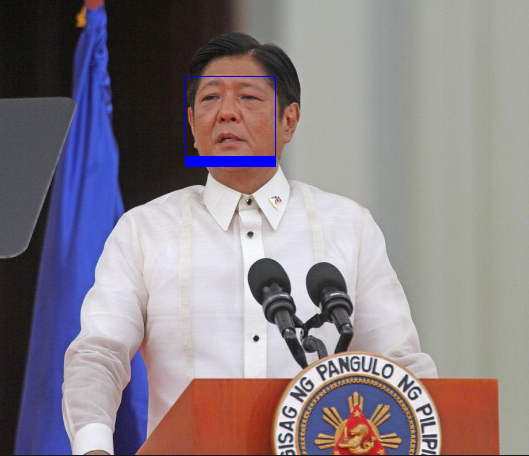

Looking for faces in bbm04.png
- Found Bongbong Marcos at (167, 116)
b'Bongbong Marcos'


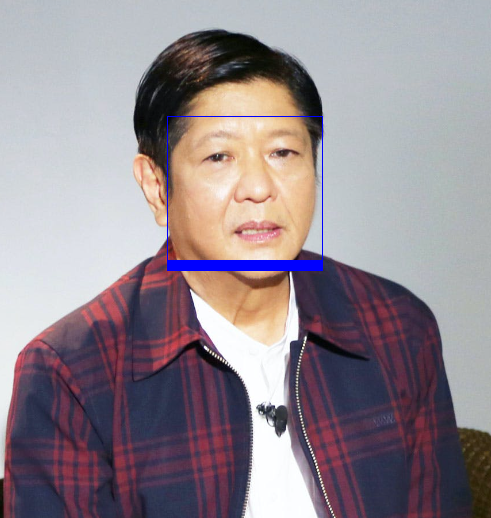

Looking for faces in bbm05.png
- Found Bongbong Marcos at (167, 93)
b'Bongbong Marcos'


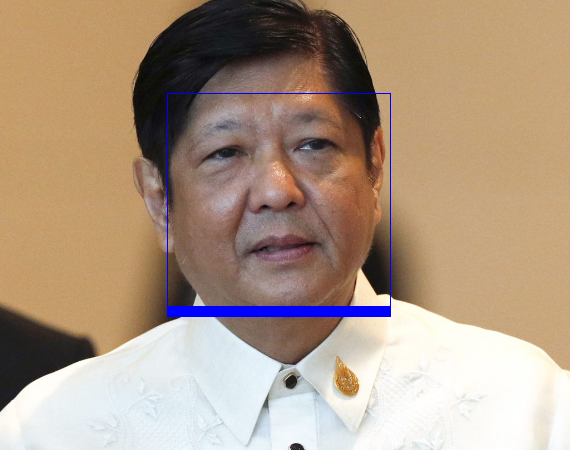

Looking for faces in bbm06.png
- Found Bongbong Marcos at (339, 168)
b'Bongbong Marcos'


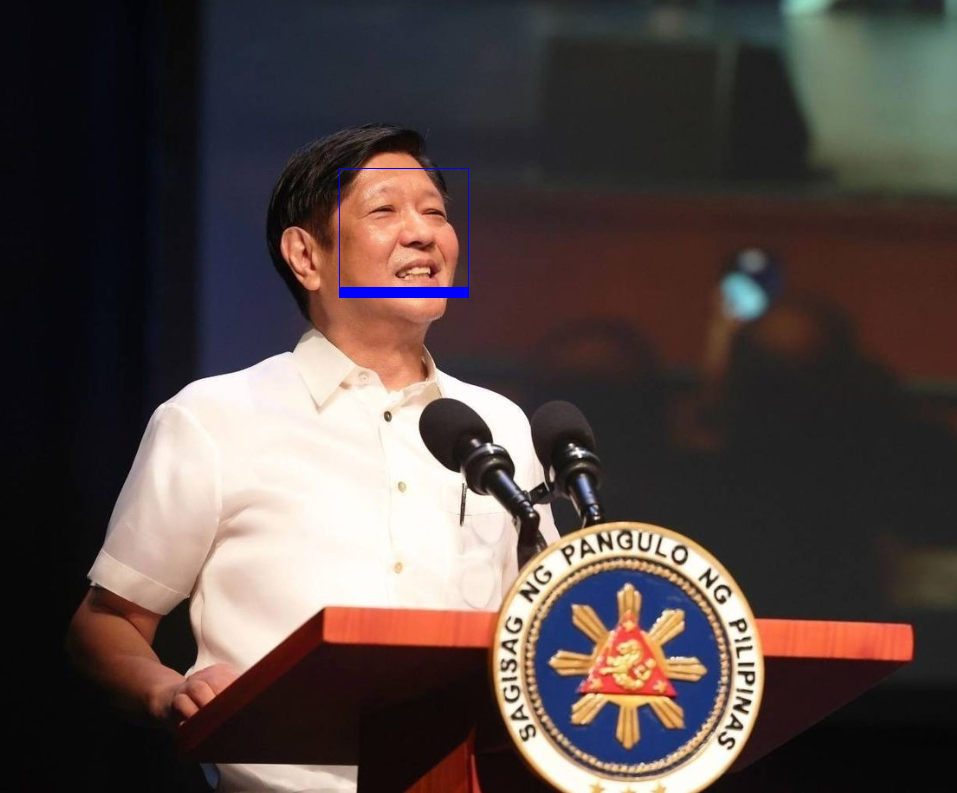

Looking for faces in ferdinand01.png
- Found Ferdinand Marcos at (218, 98)
b'Ferdinand Marcos'


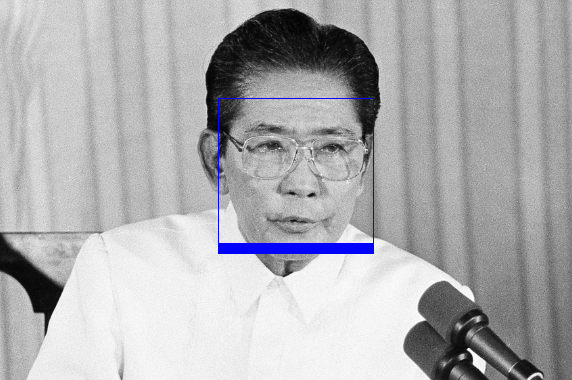

Looking for faces in ferdinand02.png
- Found Ferdinand Marcos at (167, 116)
b'Ferdinand Marcos'


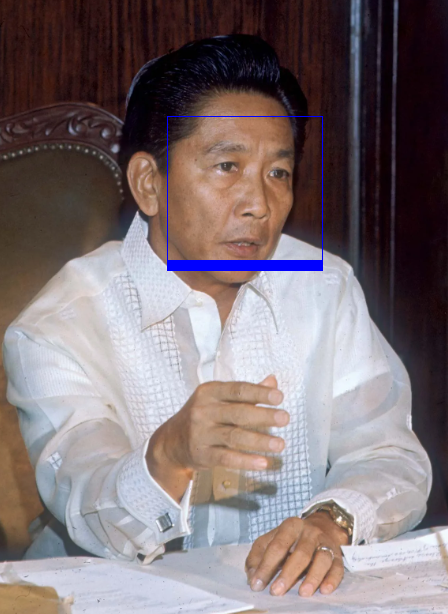

Looking for faces in ferdinand03.png
- Found Ferdinand Marcos at (196, 110)
b'Ferdinand Marcos'


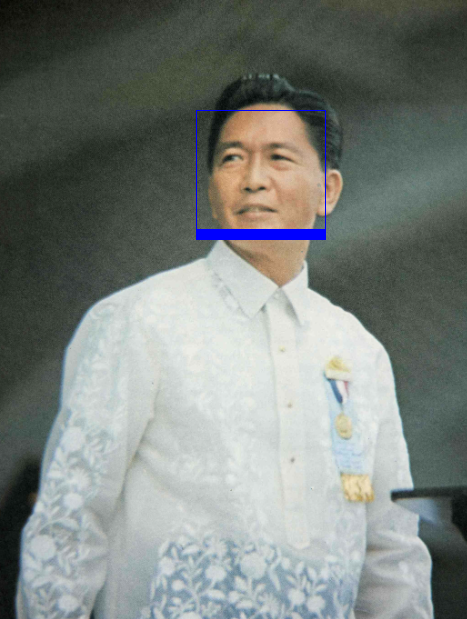

Looking for faces in ferdinand04.png
- Found Ferdinand Marcos at (223, 104)
b'Ferdinand Marcos'


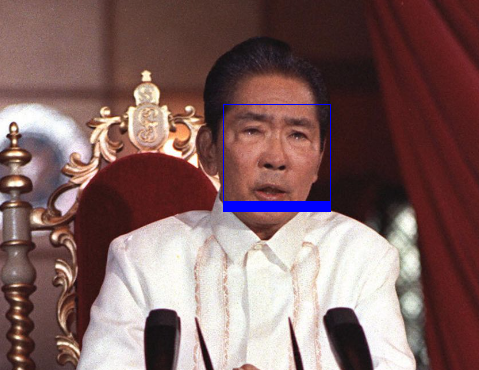

Looking for faces in ferdinand05.png
- Found Ferdinand Marcos at (163, 32)
b'Ferdinand Marcos'


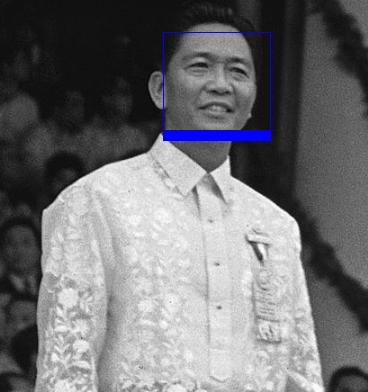

Looking for faces in diosdado01.png
- Found Diosdado Macapagal at (111, 112)
b'Diosdado Macapagal'


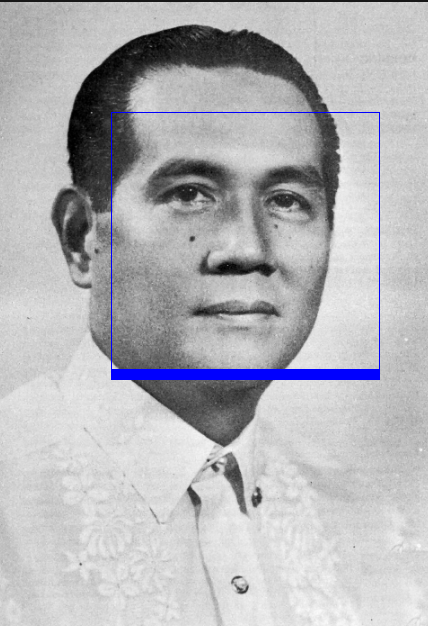

Looking for faces in diosdado02.png
- Found Diosdado Macapagal at (139, 53)
b'Diosdado Macapagal'


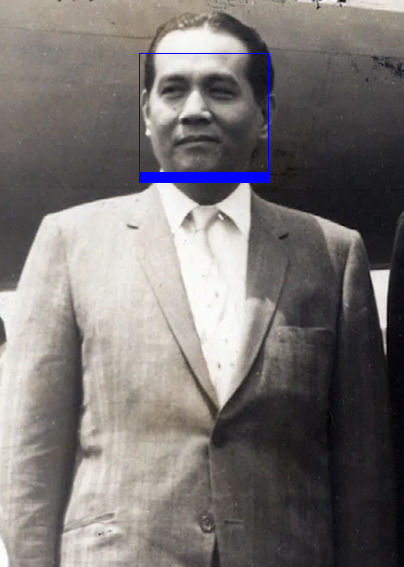

In [ ]:
#https://github.com/ageitgey/face_recognition/blob/master/examples/face_recognition_knn.py

from IPython import display
"""
This is an example of using the k-nearest-neighbors (KNN) algorithm for face recognition.

When should I use this example?
This example is useful when you wish to recognize a large set of known people,
and make a prediction for an unknown person in a feasible computation time.

Algorithm Description:
The knn classifier is first trained on a set of labeled (known) faces and can then predict the person
in an unknown image by finding the k most similar faces (images with closet face-features under euclidean distance)
in its training set, and performing a majority vote (possibly weighted) on their label.

For example, if k=3, and the three closest face images to the given image in the training set are one image of Biden
and two images of Obama, The result would be 'Obama'.

* This implementation uses a weighted vote, such that the votes of closer-neighbors are weighted more heavily.

Usage:

1. Prepare a set of images of the known people you want to recognize. Organize the images in a single directory
   with a sub-directory for each known person.

2. Then, call the 'train' function with the appropriate parameters. Make sure to pass in the 'model_save_path' if you
   want to save the model to disk so you can re-use the model without having to re-train it.

3. Call 'predict' and pass in your trained model to recognize the people in an unknown image.

NOTE: This example requires scikit-learn to be installed! You can install it with pip:

$ pip3 install scikit-learn

"""

ALLOWED_EXTENSIONS = {'png', 'jpg', 'jpeg'}


def predict(X_img_path, knn_clf=None, model_path=None, distance_threshold=0.6):
    """
    Recognizes faces in given image using a trained KNN classifier

    :param X_img_path: path to image to be recognized
    :param knn_clf: (optional) a knn classifier object. if not specified, model_save_path must be specified.
    :param model_path: (optional) path to a pickled knn classifier. if not specified, model_save_path must be knn_clf.
    :param distance_threshold: (optional) distance threshold for face classification. the larger it is, the more chance
           of mis-classifying an unknown person as a known one.
    :return: a list of names and face locations for the recognized faces in the image: [(name, bounding box), ...].
        For faces of unrecognized persons, the name 'unknown' will be returned.
    """
    if not os.path.isfile(X_img_path) or os.path.splitext(X_img_path)[1][1:] not in ALLOWED_EXTENSIONS:
        raise Exception("Invalid image path: {}".format(X_img_path))

    if knn_clf is None and model_path is None:
        raise Exception("Must supply knn classifier either through knn_clf or model_path")

    # Load a trained KNN model (if one was passed in)
    if knn_clf is None:
        with open(model_path, 'rb') as f:
            knn_clf = pickle.load(f)

    # Load image file and find face locations
    X_img = face_recognition.load_image_file(X_img_path)
    X_face_locations = face_recognition.face_locations(X_img)

    # If no faces are found in the image, return an empty result.
    if len(X_face_locations) == 0:
        return []

    # Find encodings for faces in the test iamge
    faces_encodings = face_recognition.face_encodings(X_img, known_face_locations=X_face_locations)

    # Use the KNN model to find the best matches for the test face
    closest_distances = knn_clf.kneighbors(faces_encodings, n_neighbors=1)
    are_matches = [closest_distances[0][i][0] <= distance_threshold for i in range(len(X_face_locations))]

    # Predict classes and remove classifications that aren't within the threshold
    return [(pred, loc) if rec else ("unknown", loc) for pred, loc, rec in zip(knn_clf.predict(faces_encodings), X_face_locations, are_matches)]


def show_prediction_labels_on_image(img_path, predictions):
    """
    Shows the face recognition results visually.

    :param img_path: path to image to be recognized
    :param predictions: results of the predict function
    :return:
    """
    pil_image = Image.open(img_path).convert("RGB")
    draw = ImageDraw.Draw(pil_image)

    for name, (top, right, bottom, left) in predictions:
        # Draw a box around the face using the Pillow module
        draw.rectangle(((left, top), (right, bottom)), outline=(0, 0, 255))

        # There's a bug in Pillow where it blows up with non-UTF-8 text
        # when using the default bitmap font
        name = name.encode("UTF-8")

        # Draw a label with a name below the face
        #text_width, text_height = draw.textsize(name)
        draw.rectangle(((left, bottom - 10), (right, bottom)), fill=(0, 0, 255), outline=(0, 0, 255))
        #draw.text((left + 6, bottom - text_height - 5), name, fill=(255, 255, 255, 255))

    # Remove the drawing library from memory as per the Pillow docs
    del draw
    print(name)
    # Display the resulting image
    display.display(pil_image)



def testTheModel(testPath, modelPath):
  for image_file in os.listdir(testPath):
    full_file_path = os.path.join(testPath, image_file)

    print("Looking for faces in {}".format(image_file))

    # Find all people in the image using a trained classifier model
    # Note: You can pass in either a classifier file name or a classifier model instance
    predictions = predict(full_file_path, model_path=modelPath)

    # Print results on the console
    for name, (top, right, bottom, left) in predictions:
        print("- Found {} at ({}, {})".format(name, left, top))

    # Display results overlaid on an image
    show_prediction_labels_on_image(os.path.join(testPath, image_file), predictions)



modelPath = "/content/drive/MyDrive/CS124P/Midterms/model/trained_knn_model.clf"
questionImgPath = '/content/drive/MyDrive/CS124P/Midterms/QuestionsSet/'

testTheModel(questionImgPath, modelPath)




